# FarmWise: Farmland Segmentation and Size Classification with YOLOv8

**Date**: April 14, 2025

This notebook implements a farm segmentation system using the **YOLOv8** architecture to identify agricultural fields from satellite imagery, calculate their sizes, and classify them for targeted recommendations.

## Project Overview

**Goal**: Create a system that can:
1. Detect and segment farmlands from satellite imagery
2. Calculate the size/area of each identified farm
3. Classify farms by size (small, medium, large)
4. Enable a recommendation system based on farm size classification

**Approach**: **YOLOv8** architecture for instance segmentation, leveraging transfer learning.

## 1. Business Understanding

### 1.1 Problem Statement

Agricultural recommendations are most effective when tailored to the specific context of a farm, with farm size being a crucial factor. Large farms may benefit from different techniques, equipment, and crop selections compared to small ones. This project aims to automatically classify farms by size from satellite imagery to enable targeted recommendations.

### 1.2 Success Criteria

- **Technical Success**: Achieve high accuracy in farmland segmentation (e.g., mAP50-95 > 0.6 for segmentation)
- **Business Success**: Enable accurate size-based classification of farms for targeted recommendations

## 2. Data Acquisition and Understanding

### 2.1 Setup and Environment Preparation

In [1]:
# Install necessary libraries, including ultralytics for YOLOv8
!pip install torch torchvision matplotlib numpy pillow scikit-learn scikit-image opencv-python roboflow tqdm ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 8.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 30.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 84.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.2/85.2 kB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 35.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 978.8/978.8 kB 51.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 112.9 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
 

In [2]:
# Import required libraries
import os
import numpy as np
import matplotlib.pyplot as plt
import torch
from PIL import Image as PILImage # Import PIL Image with an alias
import cv2
from skimage import measure
from tqdm.notebook import tqdm
from roboflow import Roboflow
import yaml
import random
from ultralytics import YOLO # Import YOLO
import warnings # Import warnings module
import pandas as pd # Import pandas for reading CSV
import traceback # Import traceback module

# Filter specific warning messages
warnings.filterwarnings("ignore", message=".*validation plots.*items per image.*")
# Optional: Filter other common but less critical warnings if needed
# warnings.filterwarnings("ignore", category=UserWarning, module='matplotlib')

# Set random seeds for reproducibility (less critical for YOLO training but good practice)
torch.manual_seed(42)
np.random.seed(42)
random.seed(42)

# Check for GPU availability and set up device
print("CUDA Available:", torch.cuda.is_available())
if torch.cuda.is_available():
    num_gpus = torch.cuda.device_count()
    print(f"Number of GPUs available: {num_gpus}")
    gpu_indices = list(range(num_gpus))
    for i in gpu_indices:
        print(f"GPU {i}: {torch.cuda.get_device_name(i)}")
    # Create device string for YOLO: '0' for one GPU, '0,1' for two, etc.
    device = ','.join(map(str, gpu_indices)) if num_gpus > 0 else 'cpu'
    print(f"Using device string for YOLO: '{device}'")
else:
    device = 'cpu'
    print("No GPU available, using CPU. Training will be significantly slower.")

# Display CUDA version if available
if torch.cuda.is_available():
    print(f"CUDA Version: {torch.version.cuda}")
    print(f"Current CUDA device index: {torch.cuda.current_device()}")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
CUDA Available: True
Number of GPUs available: 1
GPU 0: Tesla P100-PCIE-16GB
Using device string for YOLO: '0'
CUDA Version: 12.4
Current CUDA device index: 0


### 2.2 Data Acquisition from Roboflow

We acquire the dataset in YOLOv8 format, which includes images and corresponding text files with segmentation coordinates.

In [3]:
# Initialize Roboflow and load dataset
# Note: You will need to provide your Roboflow API key
try:
    rf = Roboflow(api_key="HE9CEH5JxJ3U0vXrQTOy")  # Replace with your actual API key
    project = rf.workspace("sid-mp92l").project("final-detectron-2")
    # Ensure the format is compatible with YOLOv8 segmentation (often 'yolov8' or similar)
    dataset = project.version(1).download("yolov8")
    dataset_location = dataset.location
    data_yaml_path = os.path.join(dataset_location, 'data.yaml')
    print(f"Dataset downloaded to: {dataset_location}")
    print(f"Data YAML path: {data_yaml_path}")
    # Verify data.yaml exists
    if not os.path.exists(data_yaml_path):
        print(f"\nERROR: data.yaml not found at {data_yaml_path}. YOLOv8 training requires this file.")
        # Attempt to find it one level deeper if structure is nested
        potential_yaml = os.path.join(dataset_location, project.name, 'data.yaml')
        if os.path.exists(potential_yaml):
             data_yaml_path = potential_yaml
             print(f"Found data.yaml at nested path: {data_yaml_path}")
        else:
             data_yaml_path = None # Indicate failure
             print("Please check the downloaded dataset structure.")
    else:
        print("data.yaml found successfully.")
except Exception as e:
    print(f"Error during Roboflow download or setup: {e}")
    print("Please ensure your API key is correct and the dataset exists.")
    dataset_location = None
    data_yaml_path = None

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Final-Detectron-2-1 in yolov8:: 100%|██████████| 15024/15024 [00:02<00:00, 6852.77it/s]


Dataset downloaded to: /kaggle/working/Final-Detectron-2-1
Data YAML path: /kaggle/working/Final-Detectron-2-1/data.yaml
data.yaml found successfully.


### 2.3 Dataset Exploration

Let's examine the structure of our dataset (downloaded in YOLOv8 format) and visualize some sample images with their annotations.

In [4]:
# Explore the dataset structure
def explore_directory(path, level=0):
    if not path or not os.path.isdir(path):
        print(f"Cannot explore path: {path}")
        return
    print('  ' * level + f"|-- {os.path.basename(path)}")
    try:
        items = os.listdir(path)
        for i, item in enumerate(items):
            if i >= 10 and len(items) > 15: # Show first 10 and last 5 if many items
                if i == 10:
                     print('  ' * (level + 1) + f"|-- ... ({len(items) - 15} more items) ...")
                elif i < len(items) - 5:
                     continue
            item_path = os.path.join(path, item)
            if os.path.isdir(item_path):
                explore_directory(item_path, level + 1)
            else:
                print('  ' * (level + 1) + f"|-- {item}")
    except Exception as e:
        print(f"Error exploring directory {path}: {e}")

print("Dataset Structure:")
if dataset_location:
    explore_directory(dataset_location)
else:
    print("Dataset location not defined. Cannot explore structure.")

Dataset Structure:
|-- Final-Detectron-2-1
  |-- data.yaml
  |-- train
    |-- images
      |-- 92781_53575_png_jpg.rf.3a489f6a68a07500836a830b37c28516.jpg
      |-- F_30001578_jpg.rf.72416634257ca38cebb28272bcf5d3dd.jpg
      |-- 73f777c3-image_2875_jpg.rf.6c2c7be4aa507e2e254f6af1cba1ae94.jpg
      |-- F_2542_jpg.rf.6865de6121f5104bee6a50acba3593ac.jpg
      |-- fc3a99d2-image_746_jpg.rf.e8d4c6dd090ff0ceadac5335d6ca3f29.jpg
      |-- F_30002150_jpg.rf.41de2606324b1de0c0de776ad1489b96.jpg
      |-- Image1410_jpg.rf.6efc91fa439608e7b11805aa222146eb.jpg
      |-- F_30001306_jpg.rf.0f98c3d4ae5f0da83cfca66550af1eac.jpg
      |-- tile_18_9_png_jpg.rf.517951512b2362c0b46b192b90faf147.jpg
      |-- Image1312_jpg.rf.3c60ab972bbe14b9bb8ab271bab648fb.jpg
      |-- ... (5943 more items) ...
      |-- 313110303022220_png_jpg.rf.62816a07233670f017476ee954f0f248.jpg
      |-- Image1349_jpg.rf.7f675744ef8df12508c0ce268f1aa7d5.jpg
      |-- F_30001528_jpg.rf.ecf6a9d0586878868aabdebb7d5b979a.jpg
      


--- Starting Random Sample Visualization (3 samples) ---


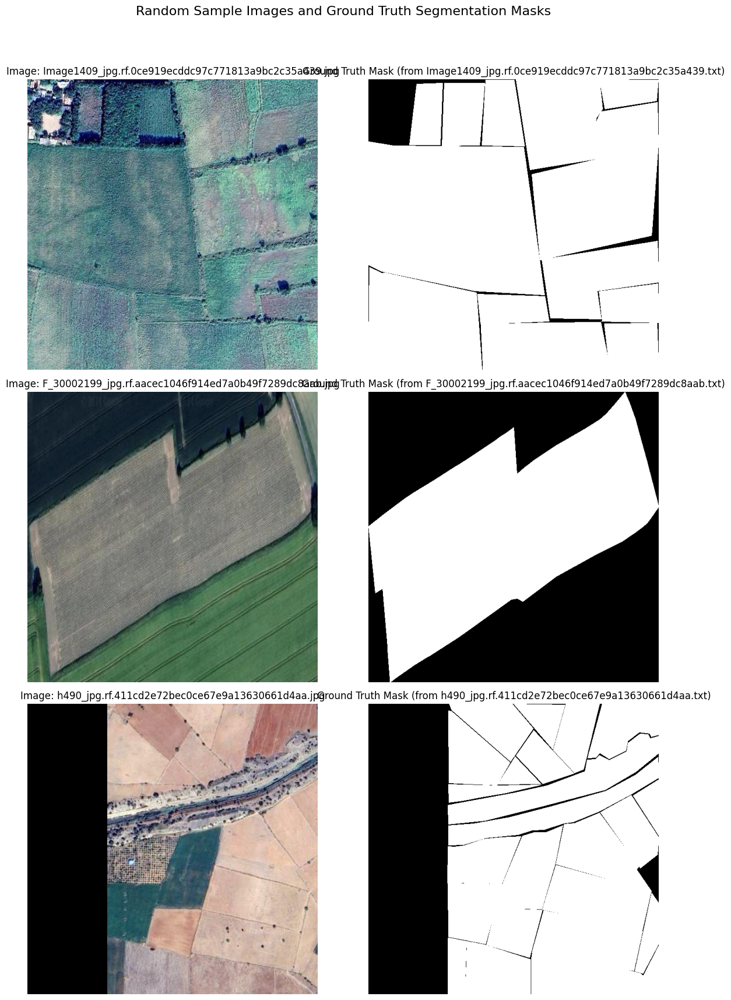

--- Finished Random Sample Visualization ---


In [5]:
# Visualization function remains largely the same, as it reads YOLO format files
import yaml
import random
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import numpy as np
import os

def visualize_yolo_segmentation_samples(data_dir, num_samples=3):
    """Visualizes original images and segmentation masks from YOLOv8 format annotations."""
    print(f"\n--- Starting Random Sample Visualization ({num_samples} samples) ---")

    if not data_dir or not os.path.isdir(data_dir):
        print(f"Error: Invalid data directory: {data_dir}")
        return

    train_img_dir = os.path.join(data_dir, 'train', 'images')
    train_label_dir = os.path.join(data_dir, 'train', 'labels')

    if not os.path.isdir(train_img_dir):
        print(f"Error: Train image directory not found: {train_img_dir}")
        return
    if not os.path.isdir(train_label_dir):
        print(f"Error: Train label directory not found: {train_label_dir}")
        return

    img_files_all = [f for f in os.listdir(train_img_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    if not img_files_all:
        print(f"No image files found in {train_img_dir}")
        return

    num_available = len(img_files_all)
    num_samples = min(num_samples, num_available)
    if num_samples == 0:
        print("No samples requested or available.")
        return
    img_files = random.sample(img_files_all, num_samples)

    yaml_path = os.path.join(data_dir, 'data.yaml')
    class_names = ['Unknown']
    if os.path.exists(yaml_path):
        try:
            with open(yaml_path, 'r') as f:
                data_yaml = yaml.safe_load(f)
            if 'names' in data_yaml:
                class_names = data_yaml['names']
        except Exception as e:
            print(f"Warning: Error reading class names from data.yaml: {e}")
    else:
        print(f"Warning: data.yaml not found at {yaml_path}.")

    fig, axes = plt.subplots(num_samples, 2, figsize=(12, 6 * num_samples))
    if num_samples == 1:
        axes = np.array([axes]) # Ensure axes is always 2D
    fig.suptitle("Random Sample Images and Ground Truth Segmentation Masks", fontsize=16)

    for i, img_file in enumerate(img_files):
        ax_img, ax_mask = axes[i]
        img_path = os.path.join(train_img_dir, img_file)
        try:
            img = Image.open(img_path).convert("RGB")
            img_np = np.array(img)
            img_height, img_width = img_np.shape[:2]
        except Exception as e:
            print(f"Error loading image {img_file}: {e}")
            ax_img.set_title(f"Error loading {img_file}")
            ax_img.axis('off')
            ax_mask.set_title("Mask N/A")
            ax_mask.axis('off')
            continue

        label_file = os.path.splitext(img_file)[0] + '.txt'
        label_path = os.path.join(train_label_dir, label_file)
        segmentation_mask = np.zeros((img_height, img_width), dtype=np.uint8)

        ax_img.imshow(img_np)
        ax_img.set_title(f"Image: {img_file}")
        ax_img.axis('off')

        if os.path.exists(label_path):
            try:
                with open(label_path, 'r') as f:
                    lines = f.readlines()
                for line_idx, line in enumerate(lines):
                    parts = line.strip().split(' ')
                    if len(parts) < 5: continue # Need at least class + 2 points for segmentation
                    class_id = int(parts[0])
                    # Assuming polygon format: class x1 y1 x2 y2 ...
                    if len(parts) % 2 == 1:
                        polygon_points_normalized = []
                        for j in range(1, len(parts), 2):
                            if j + 1 < len(parts):
                                try:
                                    x_norm = float(parts[j])
                                    y_norm = float(parts[j+1])
                                    polygon_points_normalized.append((x_norm, y_norm))
                                except ValueError:
                                    print(f"Warning: Invalid coordinate in {label_file}, line {line_idx+1}")
                                    polygon_points_normalized = [] # Reset for this line
                                    break
                        if len(polygon_points_normalized) >= 3:
                            polygon_points_pixels = [(int(x*img_width), int(y*img_height)) for x,y in polygon_points_normalized]
                            pts = np.array(polygon_points_pixels, np.int32).reshape((-1, 1, 2))
                            cv2.fillPoly(segmentation_mask, [pts], 255) # Fill mask white
            except Exception as e:
                print(f"Error processing label file {label_file}: {e}")
                ax_mask.set_title("Error reading labels")
        else:
            ax_mask.set_title("Label file missing")

        ax_mask.imshow(segmentation_mask, cmap='gray')
        ax_mask.set_title(f"Ground Truth Mask (from {label_file})")
        ax_mask.axis('off')

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()
    print("--- Finished Random Sample Visualization ---")

# Run the visualization
if dataset_location:
    try:
        num_visual_samples = 3
        visualize_yolo_segmentation_samples(dataset_location, num_samples=num_visual_samples)
    except Exception as e:
        import traceback
        traceback.print_exc()
        print(f"An unexpected error occurred during visualization: {e}")
else:
    print("\nError: Dataset location not defined. Cannot run visualization.")

### 2.4 Data Preparation

The data downloaded from Roboflow in YOLOv8 format is already structured correctly for YOLOv8 training. It expects a specific directory structure (`train/images`, `train/labels`, `valid/images`, `valid/labels`) and a `data.yaml` file defining the paths and class names.

We just need to ensure the `data.yaml` path is correctly identified.

In [6]:
# Verify the data.yaml path again and print its contents
if data_yaml_path and os.path.exists(data_yaml_path):
    print(f"Using data configuration file: {data_yaml_path}")
    try:
        with open(data_yaml_path, 'r') as f:
            data_config = yaml.safe_load(f)
        print("\nContents of data.yaml:")
        print(yaml.dump(data_config))
        
        # Optional: Check if paths in data.yaml are relative/absolute and adjust if needed
        # This might be necessary if the YAML paths are incorrect relative to the notebook's execution location
        # Example check (adjust logic as needed):
        # if not os.path.isabs(data_config['train']):
        #    data_config['train'] = os.path.join(dataset_location, data_config['train'])
        #    data_config['val'] = os.path.join(dataset_location, data_config['val'])
        #    print("\nAdjusted paths in data_config to be absolute (if necessary).")
        
    except Exception as e:
        print(f"Error reading or parsing data.yaml: {e}")
        data_yaml_path = None # Mark as invalid
else:
    print("ERROR: data.yaml path is not valid or file doesn't exist.")
    print("YOLOv8 training cannot proceed without a valid data.yaml file.")
    # You might need to manually create or correct the data.yaml file here
    # It should look something like this:
    # train: ../train/images
    # val: ../valid/images
    # 
    # nc: 1  # number of classes
    # names: ['farm'] # class names

Using data configuration file: /kaggle/working/Final-Detectron-2-1/data.yaml

Contents of data.yaml:
names:
- Farms
nc: 1
roboflow:
  license: MIT
  project: final-detectron-2
  url: https://universe.roboflow.com/sid-mp92l/final-detectron-2/dataset/1
  version: 1
  workspace: sid-mp92l
test: ../test/images
train: ../train/images
val: ../valid/images



*(Removed Custom Dataset and DataLoader setup as YOLOv8 handles data loading internally based on `data.yaml`)*

## 3. Modeling with YOLOv8

### 3.1 Transfer Learning with Pre-trained YOLOv8

We will use a pre-trained YOLOv8 segmentation model (`yolov8n-seg.pt`) as a starting point. This leverages knowledge learned from a large dataset (COCO) and allows for faster convergence and better performance on our specific farmland segmentation task. This process is known as **transfer learning** or **fine-tuning**.

In [7]:
# Load a pre-trained YOLOv8 segmentation model
try:
    # Choose a model size (n, s, m, l, x) - 'l' is large
    model_name = 'yolov8l-seg.pt' # Changed to large model
    model = YOLO(model_name)
    print(f"Successfully loaded pre-trained model: {model_name}")
    
    # Move model to the appropriate device (handled internally by YOLO, but good to confirm)
    # model.to(device) # YOLO handles device assignment during train/val/predict
    print(f"Model will use device(s): {device} during operations")
    
except Exception as e:
    print(f"Error loading YOLO model: {e}")
    print("Ensure 'ultralytics' is installed and the model name is correct.")
    model = None

100%|██████████| 88.1M/88.1M [00:02<00:00, 37.0MB/s]


Successfully loaded pre-trained model: yolov8l-seg.pt
Model will use device(s): 0 during operations


**Note:** Yes, the model loaded (`yolov8l-seg.pt`) is specifically a **segmentation** model provided by Ultralytics. It predicts both bounding boxes and pixel-level masks for detected objects.

### 3.2 Training / Fine-tuning the Model

We will now train (fine-tune) the pre-trained YOLOv8 model on our custom farmland dataset using the configuration specified in `data.yaml`.

In [8]:
# Training configuration
num_epochs = 30  # Reduced number of epochs
image_size = 640 # YOLOv8 default, adjust if needed
batch_size = 16  # Reverted batch size for safety
project_name = 'FarmWise_YOLOv8_Segmentation'
run_name = 'initial_finetune_large_mem_optimized_aug'

if model and data_yaml_path:
    print("\nStarting YOLOv8 training...")
    print("The output below will show progress per epoch, including:")
    print("- Epoch number")
    print("- Losses (box, segmentation, classification)")
    print("- Key metrics (e.g., mAP50, mAP50-95 for segmentation)")
    print("- Time per epoch")
    print("- Estimated time remaining (ETA)")
    try:
        # Train the model
        # verbose=True (default) provides detailed epoch-by-epoch updates including metrics and ETA.
        results = model.train(
            data=data_yaml_path, 
            epochs=num_epochs, 
            imgsz=image_size, 
            batch=batch_size, 
            device=device, # Pass the potentially multi-GPU device string
            project=project_name, # Directory to save results
            name=run_name, # Subdirectory for this specific run
            exist_ok=True, # Allow overwriting previous runs with the same name
            patience=10, # Early stopping patience
            verbose=True, # Show detailed training progress (includes stats, metrics, ETA per epoch)
            optimizer='AdamW', # Use AdamW optimizer for better performance
            lr0=0.001, # Initial learning rate
            lrf=0.01, # Final learning rate factor for cosine annealing scheduler
            weight_decay=0.0005, # Weight decay for regularization
            # Adjusted augmentation settings for lower memory
            augment=True, 
            degrees=10.0, # Slightly reduced rotation
            translate=0.1, # Slightly reduced translation
            scale=0.5, # Keep scale
            shear=3.0, # Slightly reduced shear
            perspective=0.0001, # Reduced perspective
            flipud=0.5, # Keep flip up-down
            fliplr=0.5, # Keep flip left-right
            mosaic=1.0, # Keep mosaic
            mixup=0.05, # Slightly reduced mixup
            copy_paste=0.0 # Disabled copy-paste (can be memory intensive)
        )
        print("\nTraining completed.")
        print(f"Results, logs, plots, and model weights saved to: {results.save_dir}")
        # The best model checkpoint is usually saved as 'best.pt' in the run directory's weights folder
        best_model_path = os.path.join(results.save_dir, 'weights', 'best.pt')
        if os.path.exists(best_model_path):
             print(f"Best model saved at: {best_model_path}")
        else:
             print(f"Could not find 'best.pt' in {os.path.join(results.save_dir, 'weights')}. Check training output.")
             # Fallback: try finding last.pt
             last_model_path = os.path.join(results.save_dir, 'weights', 'last.pt')
             if os.path.exists(last_model_path):
                 print(f"Using last model checkpoint: {last_model_path}")
                 best_model_path = last_model_path
             else:
                 best_model_path = None
        
    except Exception as e:
        print(f"\nAn error occurred during YOLOv8 training: {e}")
        traceback.print_exc()
        best_model_path = None
else:
    print("\nSkipping training: Model or data.yaml path not available.")
    best_model_path = None


Starting YOLOv8 training...
The output below will show progress per epoch, including:
- Epoch number
- Losses (box, segmentation, classification)
- Key metrics (e.g., mAP50, mAP50-95 for segmentation)
- Time per epoch
- Estimated time remaining (ETA)
Ultralytics 8.3.111 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=segment, mode=train, model=yolov8l-seg.pt, data=/kaggle/working/Final-Detectron-2-1/data.yaml, epochs=30, time=None, patience=10, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=FarmWise_YOLOv8_Segmentation, name=initial_finetune_large_mem_optimized_aug, exist_ok=True, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou

100%|██████████| 755k/755k [00:00<00:00, 3.72MB/s]
E0000 00:00:1745192898.854057      19 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1745192898.917776      19 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  3    279808  ultralytics.nn.modules.block.C2f             [128, 128, 3, True]           
  3                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  4                  -1  6   2101248  ultralytics.nn.modules.block.C2f             [256, 256, 6, True]           
  5                  -1  1   1180672  ultralytics.nn.modules.conv.Conv             [256, 512, 3, 2]              
  6                  -1  6   8396800  ultralytics.nn.modules.block.C2f             [512, 512, 6, True]           
  7                  -1  1   2360320  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 15.9MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1268.7±374.6 MB/s, size: 47.1 KB)


train: Scanning /kaggle/working/Final-Detectron-2-1/train/labels... 5958 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5958/5958 [00:05<00:00, 995.66it/s]

train: WARNING ⚠️ /kaggle/working/Final-Detectron-2-1/train/images/92751_53418_png_jpg.rf.6160a5c10e3d17809623ca3c2f82d2d9.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/Final-Detectron-2-1/train/images/92754_53535_png_jpg.rf.aa19883210d0e7ba476a875e6e90c7c1.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/Final-Detectron-2-1/train/images/92762_53436_png_jpg.rf.b99fef51564cfe38cc425884616c8010.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/Final-Detectron-2-1/train/images/Screenshot-2024-05-29-102408_png_jpg.rf.18251eb8be60e4aa8782cc3e4d32f9ca.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/Final-Detectron-2-1/train/images/tile_11_8_png_jpg.rf.1178fd50903b4446994608aa048e388e.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/Final-Detectron-2-1/train/images/tile_8_12_png_jpg.rf.33725895e02f1b2bb33c40e91b611abd.jpg: 1 duplicate labels removed


train: New cache created: /kaggle/working/Final-Detectron-2-1/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 513.3±176.0 MB/s, size: 44.3 KB)


val: Scanning /kaggle/working/Final-Detectron-2-1/valid/labels... 718 images, 0 backgrounds, 0 corrupt: 100%|██████████| 718/718 [00:01<00:00, 389.57it/s]


val: New cache created: /kaggle/working/Final-Detectron-2-1/valid/labels.cache
Plotting labels to FarmWise_YOLOv8_Segmentation/initial_finetune_large_mem_optimized_aug/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 106 weight(decay=0.0), 117 weight(decay=0.0005), 116 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to FarmWise_YOLOv8_Segmentation/initial_finetune_large_mem_optimized_aug
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/30        12G     0.9324      1.958      1.065      1.245        131        640: 100%|██████████| 373/373 [07:24<00:00,  1.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:21<00:00,  1.09it/s]


                   all        718      10665      0.722      0.715      0.764      0.584      0.673      0.652      0.664      0.355

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/30      12.3G     0.9324      1.865     0.9675       1.25         98        640: 100%|██████████| 373/373 [07:19<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:21<00:00,  1.07it/s]


                   all        718      10665      0.717      0.714      0.761      0.587      0.717      0.708       0.75       0.51

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/30      12.5G     0.9034      1.784     0.9151      1.234         89        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:21<00:00,  1.09it/s]

                   all        718      10665      0.744      0.739      0.789      0.614      0.738      0.729      0.775      0.534



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/30      12.5G     0.8666      1.685     0.8701       1.21         52        640: 100%|██████████| 373/373 [07:18<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:21<00:00,  1.09it/s]

                   all        718      10665      0.742      0.763       0.81      0.652      0.744       0.75      0.799      0.575



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/30      12.7G     0.8342      1.611     0.8411      1.188        111        640: 100%|██████████| 373/373 [07:17<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.10it/s]

                   all        718      10665       0.76      0.776      0.833      0.676      0.772      0.759      0.826      0.617



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/30      12.5G     0.8201      1.585     0.8007      1.178        179        640: 100%|██████████| 373/373 [07:18<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.10it/s]

                   all        718      10665       0.78      0.774      0.842      0.687      0.777      0.769      0.834      0.625



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/30      12.8G     0.7912      1.507     0.7785      1.162        132        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.10it/s]

                   all        718      10665      0.783      0.764      0.836      0.687      0.783      0.763      0.834       0.64



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/30      12.3G     0.7856       1.51     0.7683      1.157        115        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.10it/s]

                   all        718      10665      0.778      0.776      0.845      0.694       0.78      0.766      0.838      0.634



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/30      12.5G     0.7689      1.464     0.7492      1.145         40        640: 100%|██████████| 373/373 [07:18<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.10it/s]

                   all        718      10665      0.774      0.787      0.851      0.707      0.772      0.781      0.844      0.648



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/30      12.5G     0.7514      1.423      0.722      1.136        115        640: 100%|██████████| 373/373 [07:18<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.11it/s]

                   all        718      10665      0.799      0.799      0.865      0.728      0.798      0.799      0.863      0.677



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/30      12.8G      0.746      1.411     0.7182      1.132        149        640: 100%|██████████| 373/373 [07:17<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.11it/s]

                   all        718      10665      0.783      0.807      0.866      0.729      0.786      0.805      0.863      0.678



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/30      12.3G      0.727      1.356     0.6978      1.118        161        640: 100%|██████████| 373/373 [07:18<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.11it/s]

                   all        718      10665      0.791      0.807      0.868      0.728      0.796      0.804      0.865      0.686



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/30      12.7G     0.7304      1.374     0.6894      1.117        192        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.11it/s]

                   all        718      10665      0.797        0.8      0.869      0.739      0.797        0.8      0.866      0.691



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/30      12.5G     0.7172      1.339     0.6819      1.113        131        640: 100%|██████████| 373/373 [07:17<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.11it/s]

                   all        718      10665      0.803      0.819      0.876      0.746      0.802      0.822      0.875      0.699



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/30      13.2G     0.7052      1.307     0.6727        1.1         99        640: 100%|██████████| 373/373 [07:19<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:21<00:00,  1.09it/s]

                   all        718      10665      0.807      0.816      0.878      0.747      0.806      0.814      0.876      0.699



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/30      12.3G     0.7068      1.327     0.6666      1.101        102        640: 100%|██████████| 373/373 [07:19<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.10it/s]

                   all        718      10665      0.822      0.798      0.878      0.754      0.827      0.797      0.876      0.703



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/30      12.5G     0.6962      1.305     0.6568      1.096        110        640: 100%|██████████| 373/373 [07:18<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665      0.818      0.821      0.889      0.764      0.815      0.826      0.888      0.713



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/30      12.7G     0.6853      1.279     0.6393       1.09        130        640: 100%|██████████| 373/373 [07:17<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665      0.812      0.825      0.889      0.764      0.816      0.821      0.886      0.712



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/30      12.1G     0.6735      1.256     0.6257       1.08        127        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.11it/s]

                   all        718      10665       0.82      0.823      0.894      0.771      0.815      0.833      0.892      0.723



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/30      12.3G     0.6659      1.227     0.6217      1.077        105        640: 100%|██████████| 373/373 [07:18<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665      0.814      0.836      0.895      0.778      0.816      0.831       0.89      0.718


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/30      12.6G     0.6024      1.081     0.5861      1.048         72        640: 100%|██████████| 373/373 [07:11<00:00,  1.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665       0.83      0.822       0.89      0.768      0.831      0.823      0.889      0.726



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/30      12.5G     0.5903      1.054     0.5673      1.042         73        640: 100%|██████████| 373/373 [07:09<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665      0.832      0.836      0.899       0.78      0.834      0.833      0.896      0.725



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/30      12.5G     0.5835      1.036     0.5518      1.035         34        640: 100%|██████████| 373/373 [07:09<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665      0.833      0.832      0.899       0.78      0.835      0.825      0.896      0.731



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/30      12.3G     0.5794      1.016     0.5443      1.035         16        640: 100%|██████████| 373/373 [07:09<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665       0.84      0.831      0.902      0.785      0.839       0.83        0.9      0.744



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/30      12.6G     0.5699     0.9981     0.5292      1.026         90        640: 100%|██████████| 373/373 [07:10<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665      0.832      0.848      0.905      0.791      0.833      0.845      0.903      0.741



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      26/30      12.7G     0.5631     0.9817     0.5195      1.024         77        640: 100%|██████████| 373/373 [07:10<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665      0.842      0.848      0.909      0.797       0.84      0.845      0.905       0.75



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      27/30      13.4G     0.5474     0.9507     0.5035      1.015         35        640: 100%|██████████| 373/373 [07:10<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665      0.848      0.848      0.911      0.799      0.848      0.847      0.908      0.754



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      28/30      12.3G     0.5453     0.9403     0.4983      1.009         89        640: 100%|██████████| 373/373 [07:10<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665       0.84      0.858      0.912      0.801       0.84      0.855      0.907      0.746



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      29/30      12.5G     0.5383     0.9245     0.4847      1.006         71        640: 100%|██████████| 373/373 [07:10<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665       0.84      0.863      0.913      0.805      0.844      0.856       0.91      0.762



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      30/30      12.5G     0.5299       0.91     0.4707      1.001         50        640: 100%|██████████| 373/373 [07:10<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665       0.85      0.857      0.915      0.807      0.851      0.854      0.912      0.763



30 epochs completed in 3.824 hours.
Optimizer stripped from FarmWise_YOLOv8_Segmentation/initial_finetune_large_mem_optimized_aug/weights/last.pt, 92.3MB
Optimizer stripped from FarmWise_YOLOv8_Segmentation/initial_finetune_large_mem_optimized_aug/weights/best.pt, 92.3MB

Validating FarmWise_YOLOv8_Segmentation/initial_finetune_large_mem_optimized_aug/weights/best.pt...
Ultralytics 8.3.111 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLOv8l-seg summary (fused): 125 layers, 45,912,659 parameters, 0 gradients, 220.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   0%|          | 0/23 [00:00<?, ?it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   4%|▍         | 1/23 [00:00<00:21,  1.04it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   9%|▊         | 2/23 [00:02<00:26,  1.25s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  13%|█▎        | 3/23 [00:05<00:37,  1.89s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  17%|█▋        | 4/23 [00:07<00:38,  2.03s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  22%|██▏       | 5/23 [00:09<00:36,  2.02s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  26%|██▌       | 6/23 [00:10<00:28,  1.65s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  30%|███       | 7/23 [00:11<00:22,  1.38s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  35%|███▍      | 8/23 [00:11<00:18,  1.21s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  39%|███▉      | 9/23 [00:12<00:15,  1.09s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  43%|████▎     | 10/23 [00:13<00:13,  1.01s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  48%|████▊     | 11/23 [00:14<00:11,  1.05it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  52%|█████▏    | 12/23 [00:15<00:10,  1.09it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  57%|█████▋    | 13/23 [00:16<00:08,  1.13it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  61%|██████    | 14/23 [00:16<00:07,  1.15it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  65%|██████▌   | 15/23 [00:17<00:06,  1.17it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  70%|██████▉   | 16/23 [00:18<00:05,  1.18it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  74%|███████▍  | 17/23 [00:19<00:05,  1.19it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  78%|███████▊  | 18/23 [00:20<00:04,  1.17it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  83%|████████▎ | 19/23 [00:21<00:03,  1.15it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  87%|████████▋ | 20/23 [00:22<00:02,  1.12it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  91%|█████████▏| 21/23 [00:23<00:01,  1.05it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  96%|█████████▌| 22/23 [00:24<00:00,  1.02it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:24<00:00,  1.07s/it]


                   all        718      10665      0.849      0.858      0.915      0.807      0.851      0.854      0.911      0.763


invalid value encountered in less
invalid value encountered in less


Speed: 0.2ms preprocess, 21.8ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to FarmWise_YOLOv8_Segmentation/initial_finetune_large_mem_optimized_aug

Training completed.
Results, logs, plots, and model weights saved to: FarmWise_YOLOv8_Segmentation/initial_finetune_large_mem_optimized_aug
Best model saved at: FarmWise_YOLOv8_Segmentation/initial_finetune_large_mem_optimized_aug/weights/best.pt


### Training Output and Results

The cell above displays the training progress live. For each epoch, you should see:
*   Loss values (box, segmentation, classification)
*   Segmentation metrics (mAP50, mAP50-95)
*   Time taken for the epoch and estimated time remaining (ETA).

All detailed results, including metrics plots (like loss curves, PR curves), confusion matrices, and saved model checkpoints (`best.pt`, `last.pt`), are stored in the directory printed at the end of the training output (e.g., `FarmWise_YOLOv8_Segmentation/initial_finetune/`). You can inspect these files for a comprehensive analysis after training completes.

Let's display some of the key result plots generated during training, including the main results overview which contains loss curves.

Displaying plots from: FarmWise_YOLOv8_Segmentation/initial_finetune_large_mem_optimized_aug

--- results.png ---


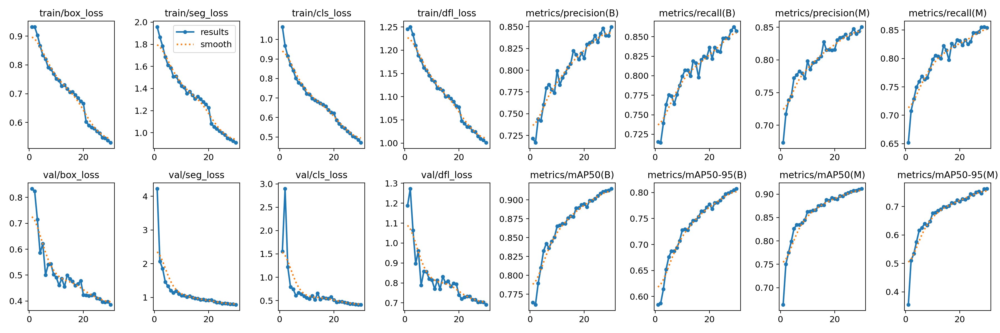


--- confusion_matrix.png ---


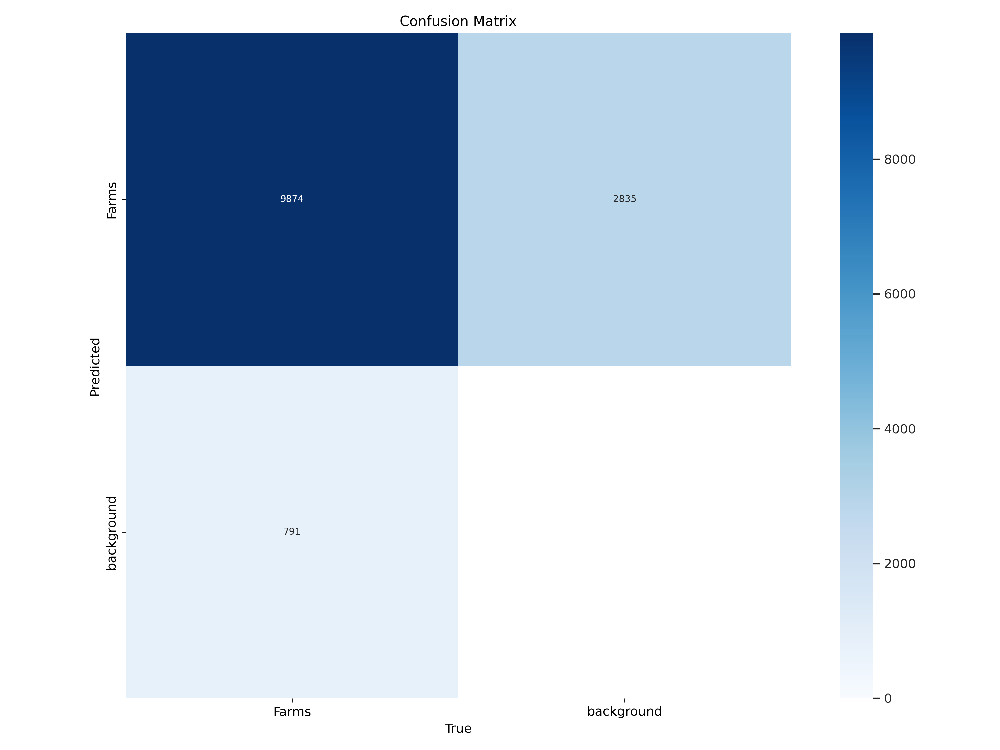


--- val_batch0_labels.jpg ---


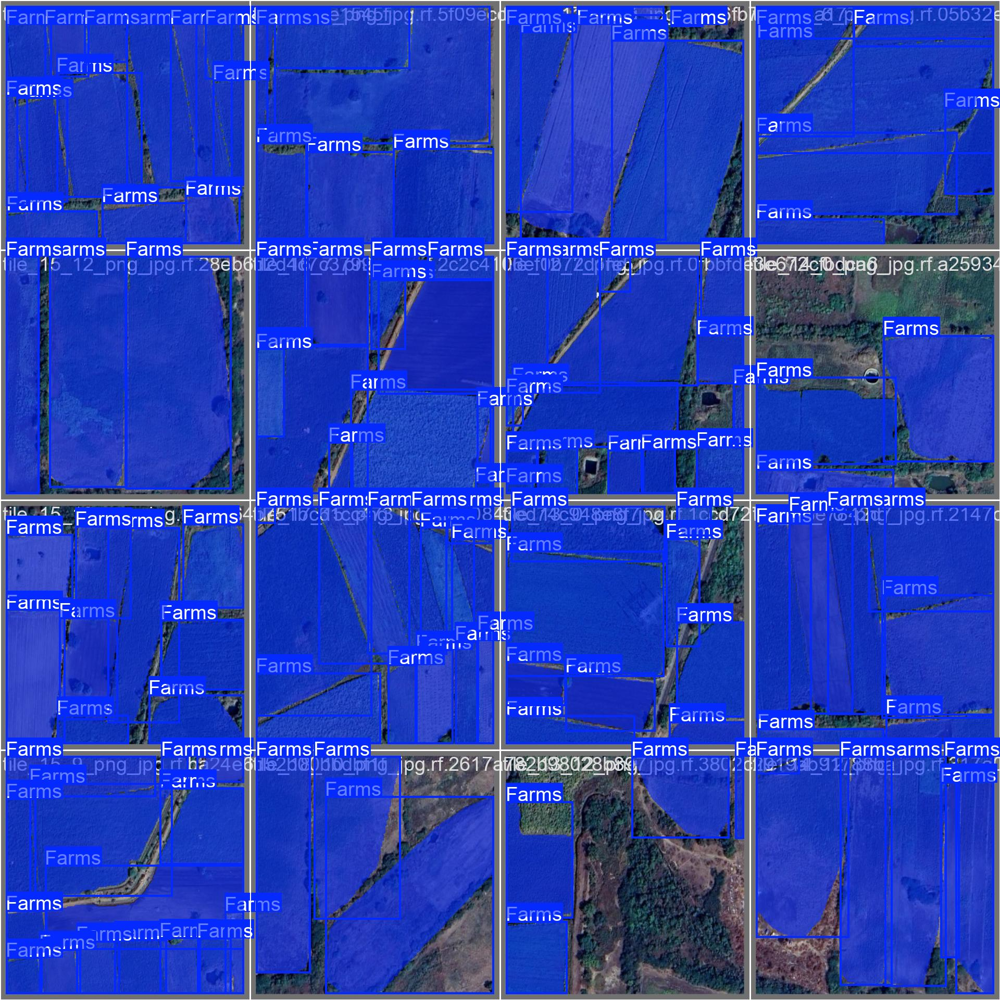


--- val_batch0_pred.jpg ---


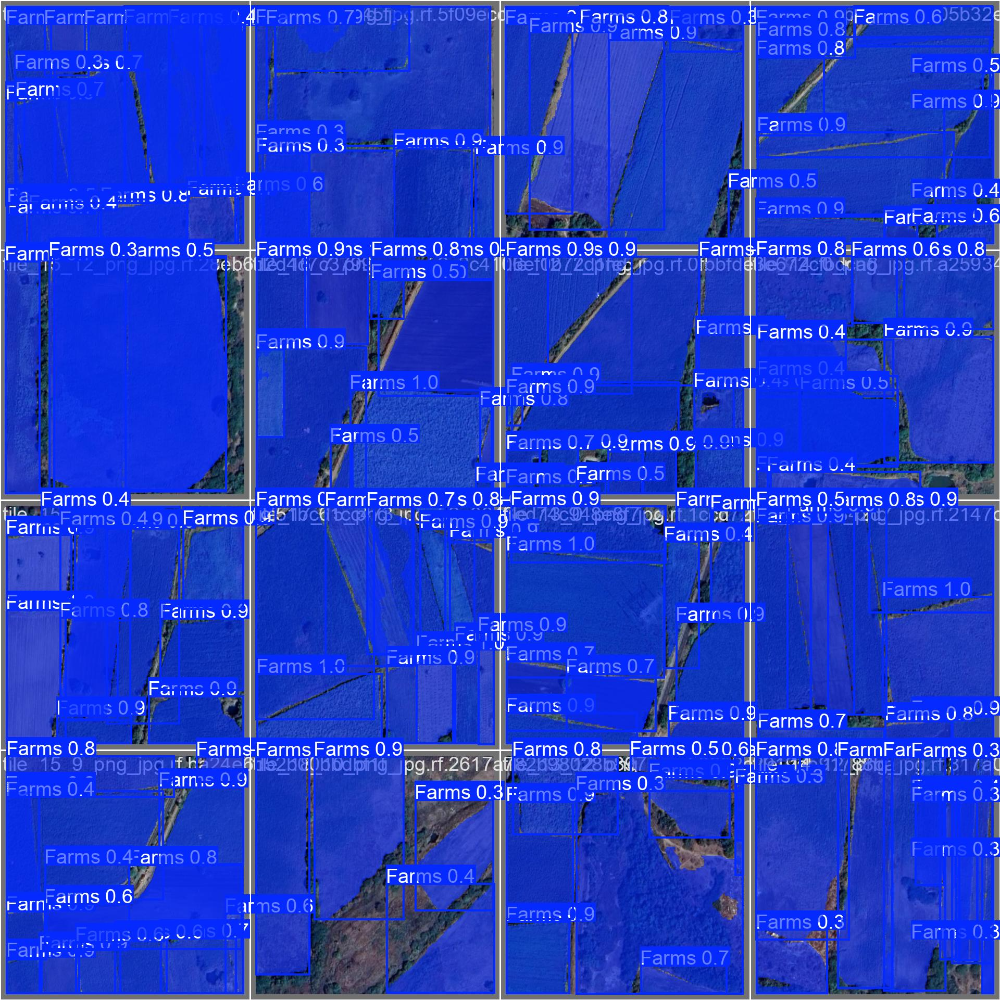

In [9]:
# Display training results plots (including loss curves in results.png)
from IPython.display import Image, display

if 'results' in locals() and hasattr(results, 'save_dir'):
    results_dir = results.save_dir
    print(f"Displaying plots from: {results_dir}")
    
    # Common plots saved by YOLOv8
    # results.png contains training/validation loss and metrics curves
    plot_files = [
        'results.png', 
        'confusion_matrix.png', 
        'val_batch0_labels.jpg', # Example batch labels
        'val_batch0_pred.jpg' # Example batch predictions
    ]
    
    found_plots = False
    for plot_file in plot_files:
        plot_path = os.path.join(results_dir, plot_file)
        if os.path.exists(plot_path):
            print(f"\n--- {plot_file} ---")
            display(Image(filename=plot_path, width=800))
            found_plots = True
        else:
            print(f"Plot not found: {plot_path}")
            
    if not found_plots:
        print("Could not find standard result plots. Check the save directory.")
        # List files if needed:
        # print("Files in results directory:", os.listdir(results_dir))
        
else:
    print("Training results object ('results') not found. Cannot display plots.")

### Detailed Loss Plots (Initial Training)

We can also plot the individual loss components from the `results.csv` file for a more granular view.

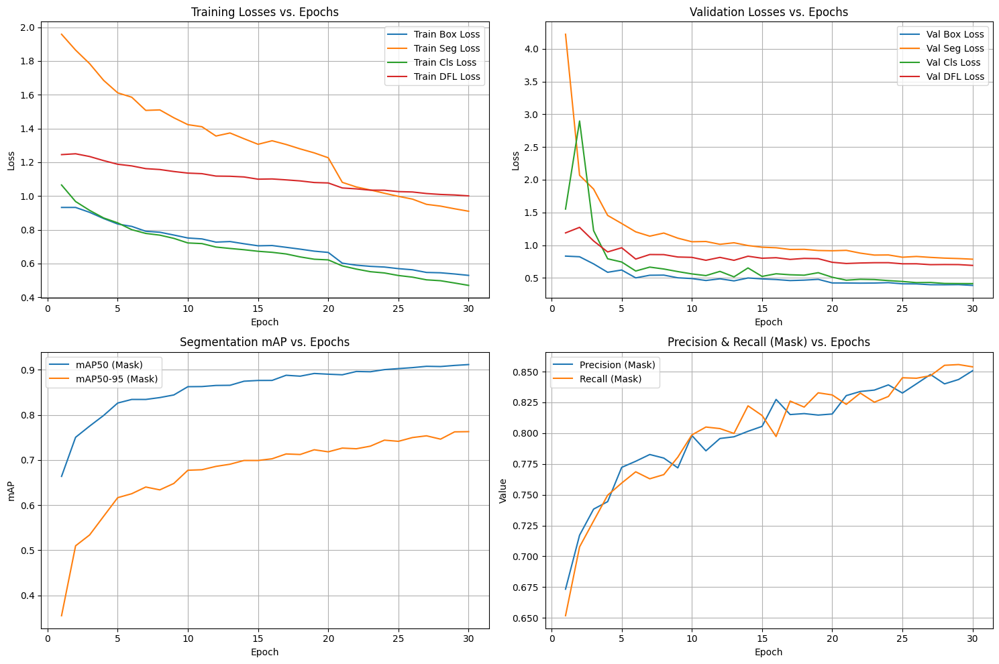

In [10]:
# Plot detailed losses from results.csv
if 'results' in locals() and hasattr(results, 'save_dir'):
    results_csv_path = os.path.join(results.save_dir, 'results.csv')
    if os.path.exists(results_csv_path):
        try:
            df = pd.read_csv(results_csv_path)
            # Clean column names (remove leading/trailing spaces)
            df.columns = df.columns.str.strip()
            
            plt.figure(figsize=(15, 10))
            
            # Plot Training Losses
            plt.subplot(2, 2, 1)
            plt.plot(df['epoch'], df['train/box_loss'], label='Train Box Loss')
            plt.plot(df['epoch'], df['train/seg_loss'], label='Train Seg Loss')
            plt.plot(df['epoch'], df['train/cls_loss'], label='Train Cls Loss')
            # DFL loss might not always be present, check first
            if 'train/dfl_loss' in df.columns:
                 plt.plot(df['epoch'], df['train/dfl_loss'], label='Train DFL Loss')
            plt.title('Training Losses vs. Epochs')
            plt.xlabel('Epoch')
            plt.ylabel('Loss')
            plt.legend()
            plt.grid(True)
            
            # Plot Validation Losses
            plt.subplot(2, 2, 2)
            plt.plot(df['epoch'], df['val/box_loss'], label='Val Box Loss')
            plt.plot(df['epoch'], df['val/seg_loss'], label='Val Seg Loss')
            plt.plot(df['epoch'], df['val/cls_loss'], label='Val Cls Loss')
            if 'val/dfl_loss' in df.columns:
                 plt.plot(df['epoch'], df['val/dfl_loss'], label='Val DFL Loss')
            plt.title('Validation Losses vs. Epochs')
            plt.xlabel('Epoch')
            plt.ylabel('Loss')
            plt.legend()
            plt.grid(True)
            
            # Plot mAP Metrics
            plt.subplot(2, 2, 3)
            plt.plot(df['epoch'], df['metrics/mAP50(M)'], label='mAP50 (Mask)')
            plt.plot(df['epoch'], df['metrics/mAP50-95(M)'], label='mAP50-95 (Mask)')
            plt.title('Segmentation mAP vs. Epochs')
            plt.xlabel('Epoch')
            plt.ylabel('mAP')
            plt.legend()
            plt.grid(True)
            
            # Plot Precision and Recall (Mask)
            plt.subplot(2, 2, 4)
            plt.plot(df['epoch'], df['metrics/precision(M)'], label='Precision (Mask)')
            plt.plot(df['epoch'], df['metrics/recall(M)'], label='Recall (Mask)')
            plt.title('Precision & Recall (Mask) vs. Epochs')
            plt.xlabel('Epoch')
            plt.ylabel('Value')
            plt.legend()
            plt.grid(True)
            
            plt.tight_layout()
            plt.show()
            
        except Exception as e:
            print(f"Error plotting losses from CSV: {e}")
            # print(df.columns) # Uncomment to debug column names
    else:
        print(f"results.csv not found at: {results_csv_path}")
else:
    print("Training results object ('results') not found. Cannot plot detailed losses.")

## 4. Model Evaluation and Visualization

Let's load our best fine-tuned model and evaluate its performance on the validation set using YOLOv8's built-in methods.

Loading best model from: FarmWise_YOLOv8_Segmentation/initial_finetune_large_mem_optimized_aug/weights/best.pt
Best model loaded successfully for evaluation.

Running validation on the loaded model...
Ultralytics 8.3.111 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLOv8l-seg summary (fused): 125 layers, 45,912,659 parameters, 0 gradients, 220.1 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1537.3±351.2 MB/s, size: 43.5 KB)


val: Scanning /kaggle/working/Final-Detectron-2-1/valid/labels.cache... 718 images, 0 backgrounds, 0 corrupt: 100%|██████████| 718/718 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   0%|          | 0/45 [00:00<?, ?it/s]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   2%|▏         | 1/45 [00:01<00:44,  1.01s/it]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   4%|▍         | 2/45 [00:01<00:40,  1.07it/s]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 45/45 [00:23<00:00,  1.89it/s]


                   all        718      10665      0.849      0.859      0.915      0.808       0.85      0.853      0.911      0.759


invalid value encountered in less
invalid value encountered in less


Speed: 0.6ms preprocess, 22.2ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to FarmWise_YOLOv8_Segmentation/initial_finetune_large_mem_optimized_aug_validation

Validation complete.
Initial Model Segmentation Metrics:
  mAP50-95 (Mask): 0.7586
  mAP50 (Mask):    0.9110

✅ Success! Achieved target mAP50-95 > 0.6 (Actual: 0.7586)

Visualizing predictions on validation images...
Selected 10 images for visualization comparison.

0: 640x640 26 Farmss, 23.8ms
1: 640x640 1 Farms, 23.8ms
2: 640x640 8 Farmss, 23.8ms
3: 640x640 1 Farms, 23.8ms
4: 640x640 1 Farms, 23.8ms
5: 640x640 1 Farms, 23.8ms
6: 640x640 1 Farms, 23.8ms
7: 640x640 29 Farmss, 23.8ms
8: 640x640 17 Farmss, 23.8ms
9: 640x640 1 Farms, 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)
Displaying 10 prediction results (Initial Model - Masks Only):


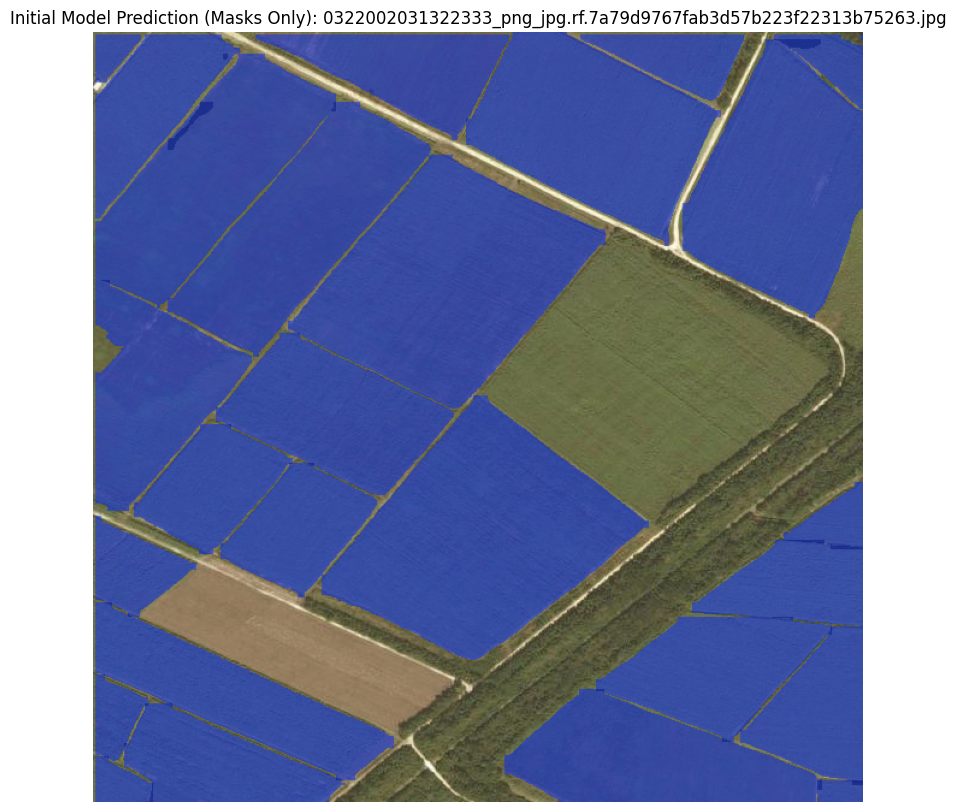

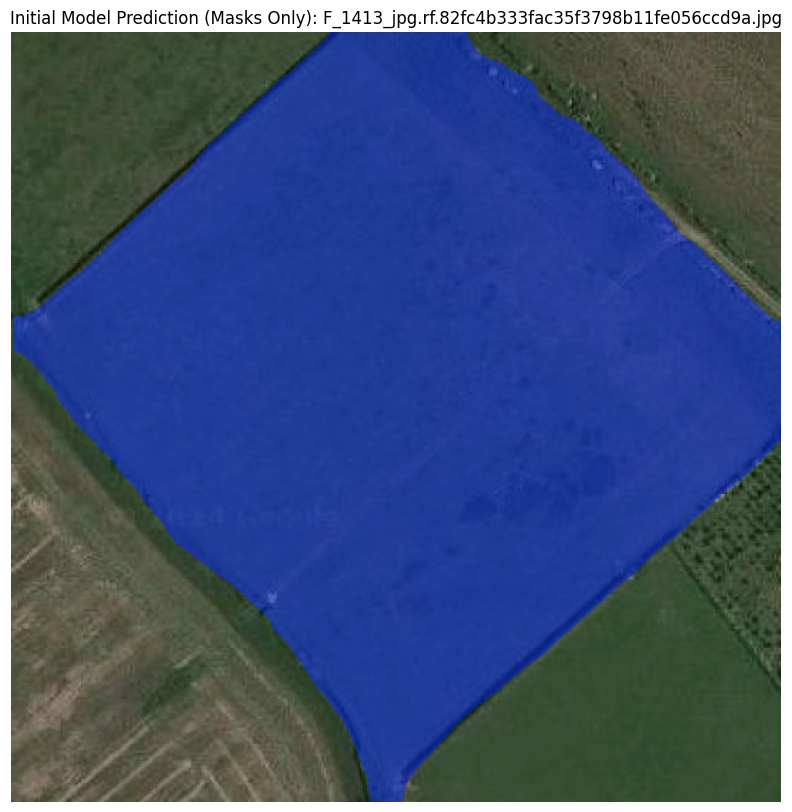

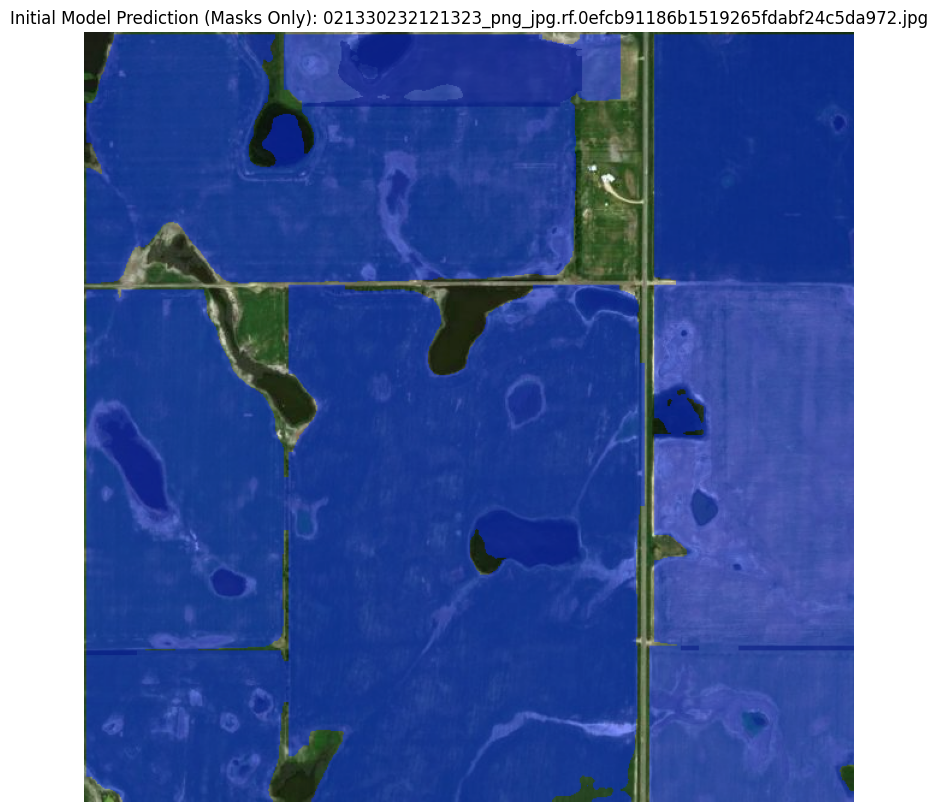

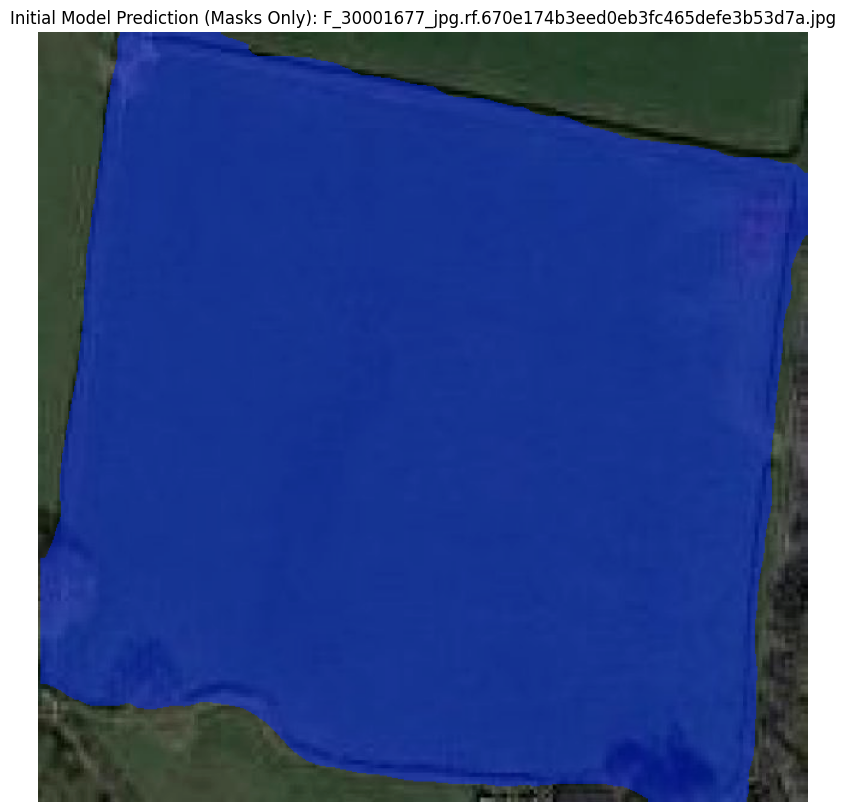

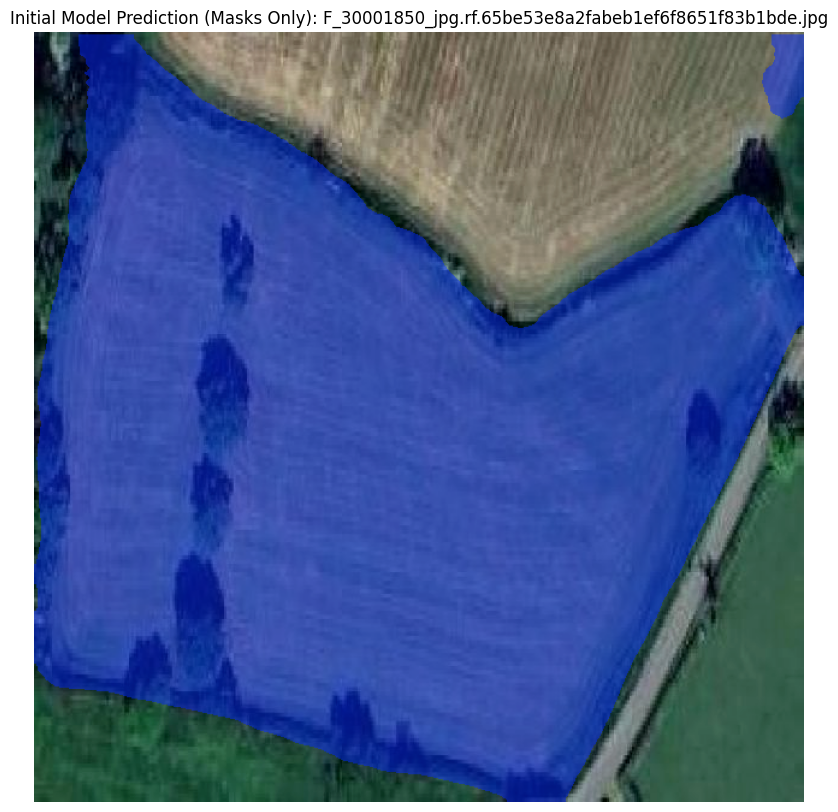

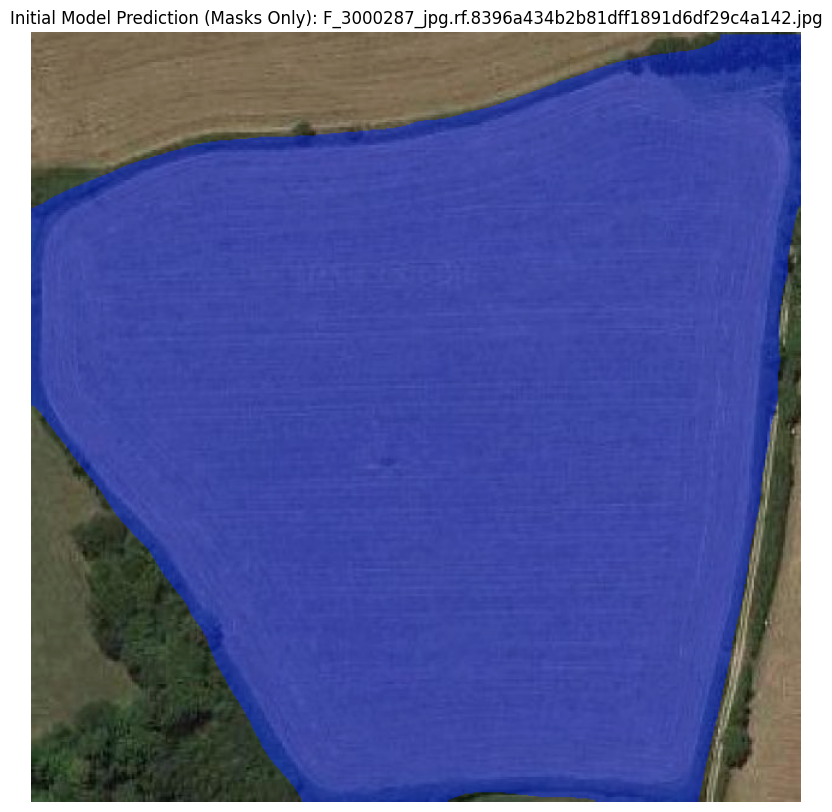

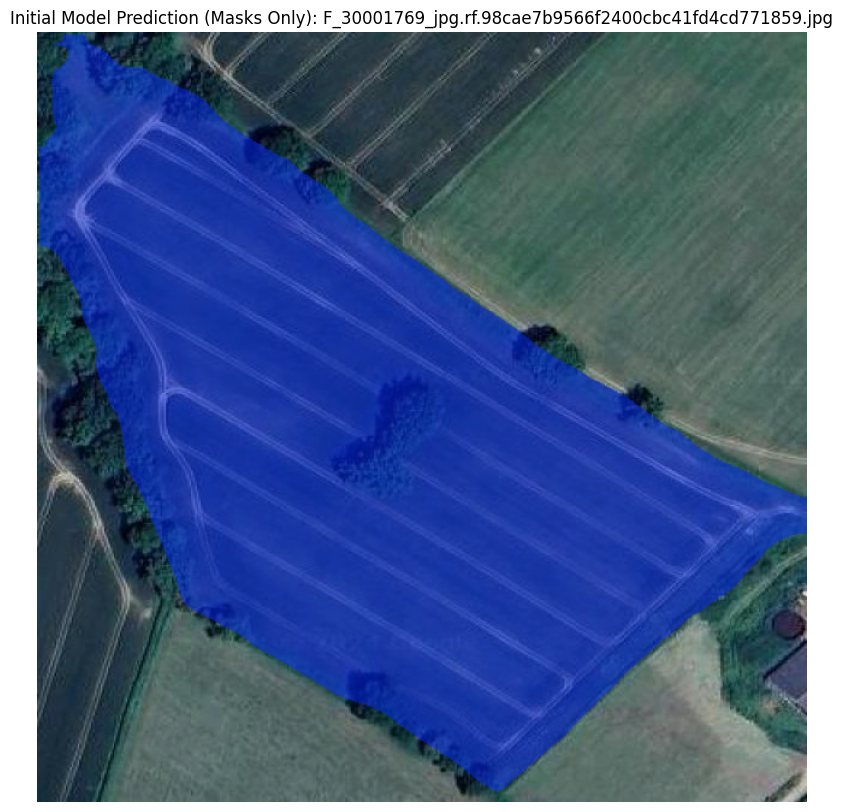

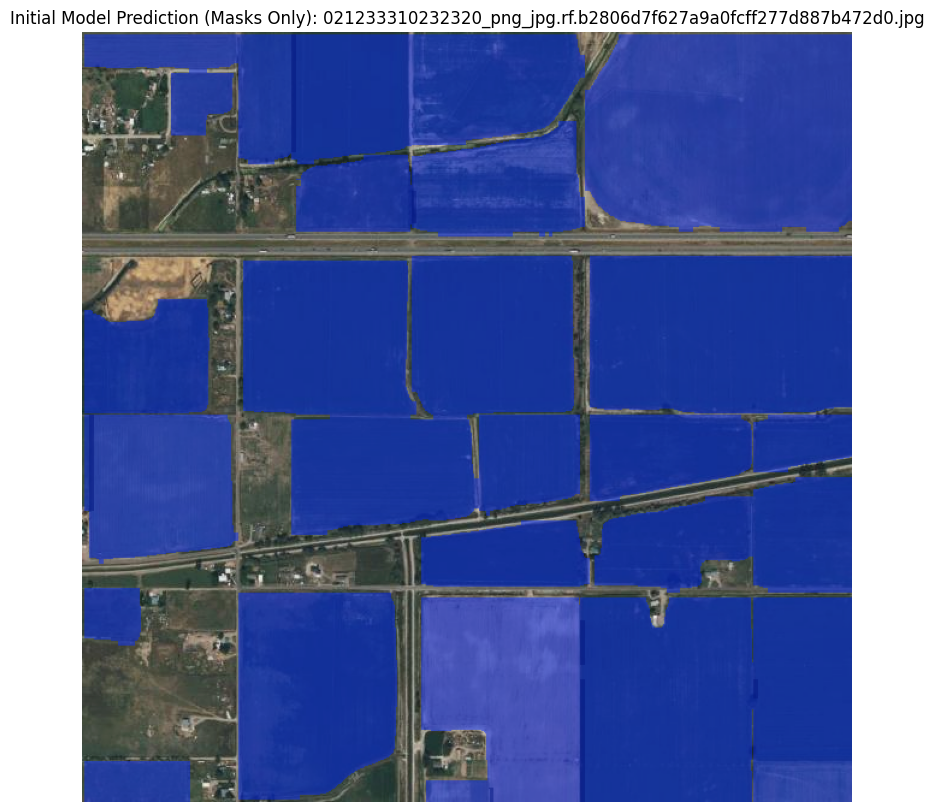

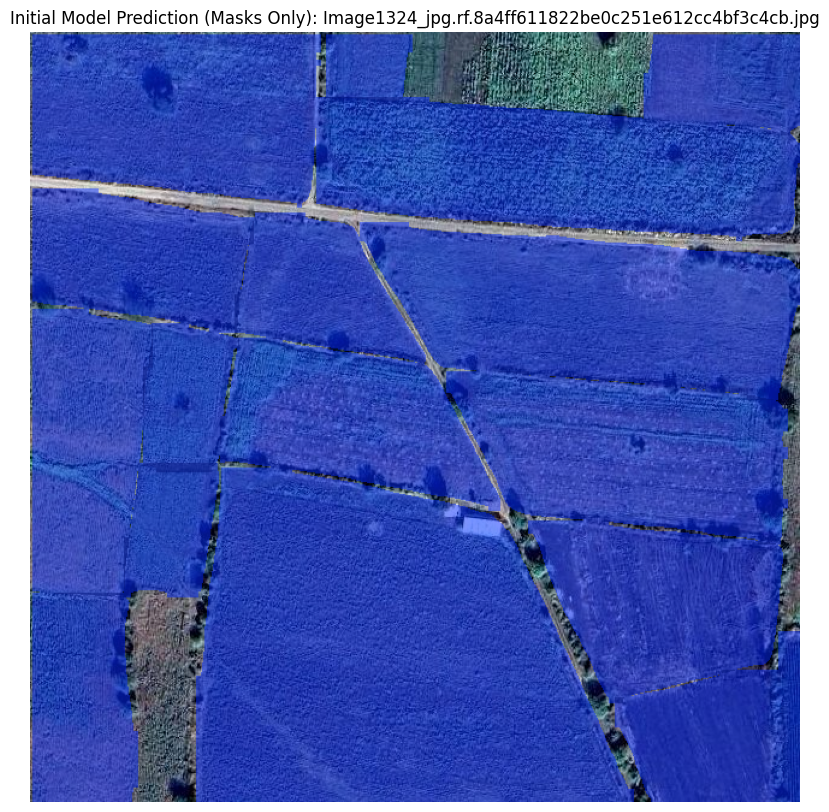

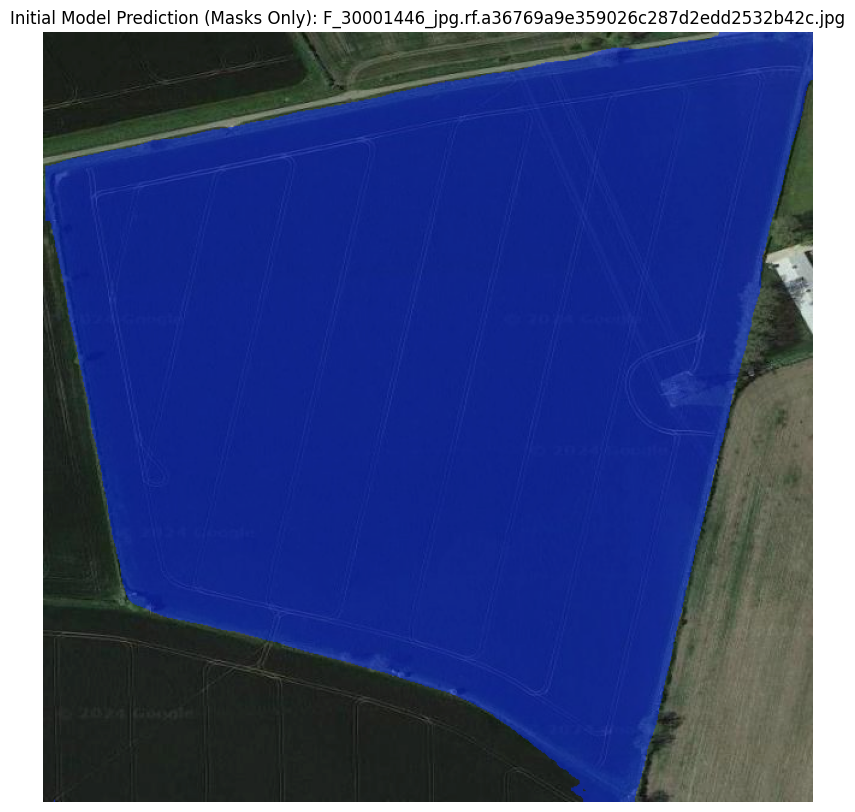

In [11]:
# Load the best model for evaluation
initial_map50_95 = None # Store initial metrics
initial_map50 = None
visualization_sample_images = [] # Store sample images for later comparison

if 'best_model_path' not in locals(): # Define if training was skipped
    # Attempt to manually define the path if needed, e.g. from a previous run
    # Use the updated run_name from the training cell
    potential_path = os.path.join(project_name, run_name, 'weights', 'best.pt')
    if os.path.exists(potential_path):
        best_model_path = potential_path
        print(f"Manually identified best model path: {best_model_path}")
    else:
        best_model_path = None
        print("best_model_path variable not found. Please ensure training ran or set the path manually.")

if best_model_path and os.path.exists(best_model_path):
    print(f"Loading best model from: {best_model_path}")
    try:
        eval_model = YOLO(best_model_path)
        print("Best model loaded successfully for evaluation.")
    except Exception as e:
        print(f"Error loading best model: {e}")
        eval_model = None
elif 'model' in locals() and model is not None: # Fallback to the model after initial loading if best.pt wasn't identified/trained
    print("Warning: Best model path not found or invalid. Using initially loaded pre-trained model for evaluation structure.")
    eval_model = model 
else:
    print("Error: No model available for evaluation.")
    eval_model = None

# --- Evaluate the Model ---
if eval_model and data_yaml_path:
    print("\nRunning validation on the loaded model...")
    try:
        metrics = eval_model.val(
            data=data_yaml_path,
            imgsz=image_size,
            batch=batch_size, # Use the reverted batch size
            split='val', # Specify the split to evaluate (usually 'val' or 'test')
            device=device, # Pass the potentially multi-GPU device string
            project=project_name,
            name=f'{run_name}_validation', # Save validation results separately
            exist_ok=True,
            plots=True # Ensure plots are generated during validation (default)
            # iou=0.6 # Default IoU threshold for metrics calculation, adjust if needed
            # conf=0.001 # Default confidence threshold for metrics calculation
        )
        print("\nValidation complete.")
        print("Initial Model Segmentation Metrics:")
        # Access specific metrics (keys might vary slightly based on YOLO version)
        # Common metrics for segmentation include mAP50-95(M) and mAP50(M)
        initial_map50_95 = metrics.seg.map  # Store for comparison
        initial_map50 = metrics.seg.map50 # Store for comparison
        print(f"  mAP50-95 (Mask): {initial_map50_95:.4f}")
        print(f"  mAP50 (Mask):    {initial_map50:.4f}")
        # Check against success criteria (adjust metric as needed)
        target_map = 0.6 # Example target mAP50-95
        if initial_map50_95 > target_map:
             print(f"\n✅ Success! Achieved target mAP50-95 > {target_map} (Actual: {initial_map50_95:.4f})")
        else:
             print(f"\n❌ Target mAP50-95 > {target_map} not achieved (Actual: {initial_map50_95:.4f})")
             
    except AttributeError:
        print("\nCould not access segmentation metrics (e.g., metrics.seg.map). This might happen if:")
        print("  - The loaded model is not a segmentation model.")
        print("  - Validation failed to produce segmentation results.")
        print("  - The Ultralytics API version has changed metric accessors.")
        print("  Check the 'metrics' object structure or validation logs.")
        # print(metrics) # Uncomment to inspect the metrics object
    except Exception as e:
        print(f"\nAn error occurred during validation: {e}")
        traceback.print_exc()
else:
    print("\nSkipping evaluation: Model or data.yaml path not available.")

# --- Visualize Predictions ---
if eval_model and dataset_location:
    print("\nVisualizing predictions on validation images...")
    val_img_dir = os.path.join(dataset_location, 'valid', 'images')
    if os.path.isdir(val_img_dir):
        val_images = [os.path.join(val_img_dir, f) for f in os.listdir(val_img_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        num_viz_samples = min(10, len(val_images)) # Increased number of visualization samples
        if num_viz_samples > 0:
            # Store the sampled images for later use with the re-trained model
            visualization_sample_images = random.sample(val_images, num_viz_samples)
            print(f"Selected {len(visualization_sample_images)} images for visualization comparison.")
            try:
                # Run prediction with NMS settings to reduce overlap and specific confidence
                pred_results = eval_model.predict(
                    source=visualization_sample_images, # Use the stored list
                    save=False, # Don't save individual prediction images by default
                    show=False, # Don't display using cv2.imshow
                    conf=0.5, # Confidence threshold for predictions
                    iou=0.45, # Lower IoU threshold for NMS to reduce overlapping masks
                    device=device # Pass the potentially multi-GPU device string
                )
                
                # Plot results using matplotlib, hiding boxes and labels
                print(f"Displaying {len(pred_results)} prediction results (Initial Model - Masks Only):")
                for i, r in enumerate(pred_results):
                    # Use plot() with boxes=False and labels=False
                    im_bgr = r.plot(boxes=False, labels=False)  # BGR numpy array of predictions (masks only)
                    im_rgb = PILImage.fromarray(im_bgr[..., ::-1]) # Convert BGR to RGB using PILImage
                    
                    plt.figure(figsize=(10, 10))
                    plt.imshow(im_rgb)
                    plt.title(f"Initial Model Prediction (Masks Only): {os.path.basename(visualization_sample_images[i])}")
                    plt.axis('off')
                    plt.show()
                    
            except Exception as e:
                print(f"\nError during prediction or visualization: {e}")
                traceback.print_exc()
        else:
            print("No validation images found to visualize.")
    else:
        print(f"Validation image directory not found: {val_img_dir}")
else:
    print("\nSkipping prediction visualization: Model or dataset location not available.")

## 5. Post-processing: Farm Size Calculation and Classification

After segmenting the farms using the trained YOLOv8 model, we need to process the predicted masks to calculate the area of each farm and classify them based on size.

In [12]:
from skimage import measure
import numpy as np

def calculate_farm_properties(predictions, confidence_threshold=0.5, min_area_pixels=100):
    """
    Processes YOLOv8 prediction results to find farms, calculate their areas,
    and classify their size.
    
    Args:
        predictions: List of result objects from model.predict().
        confidence_threshold (float): Minimum confidence for a detection.
        min_area_pixels (int): Minimum pixel area to consider a segment a farm.
        
    Returns:
        List of dictionaries, each containing info for one image:
        {'image_path': str, 'farms': [{'id': int, 'area_pixels': float, 'size_category': str, 'confidence': float, 'bbox': list}]}
    """
    results_list = []
    farm_class_index = 0 # Assuming 'farm' is the first class (index 0) in data.yaml. Adjust if necessary.
    
    print(f"Processing {len(predictions)} prediction results...")
    
    for i, result in enumerate(predictions):
        image_path = result.path
        image_farms = []
        img_h, img_w = result.orig_shape # Original image dimensions
        
        if result.masks is None or result.boxes is None:
            # print(f"No masks or boxes found for {os.path.basename(image_path)}")
            results_list.append({'image_path': os.path.basename(image_path), 'farms': []})
            continue
            
        masks = result.masks.data.cpu().numpy() # (N, H, W) tensor of masks
        boxes = result.boxes.data.cpu().numpy() # (N, 6) tensor [x1, y1, x2, y2, conf, cls]
        
        # print(f"Processing {os.path.basename(image_path)}: Found {len(boxes)} detections.")
        
        farm_id_counter = 0
        for j in range(len(boxes)):
            confidence = boxes[j, 4]
            class_id = int(boxes[j, 5])
            
            # Filter by confidence and class (assuming farm is class 0)
            if confidence >= confidence_threshold and class_id == farm_class_index:
                mask = masks[j]
                # Resize mask to original image size if necessary (YOLO might predict on resized)
                if mask.shape[0] != img_h or mask.shape[1] != img_w:
                     mask = cv2.resize(mask, (img_w, img_h), interpolation=cv2.INTER_NEAREST)
                     
                # Calculate area (number of positive pixels in the mask)
                area_pixels = np.sum(mask > 0.5) # Use 0.5 threshold on mask probabilities
                
                if area_pixels >= min_area_pixels:
                    farm_id_counter += 1
                    bbox_xyxy = boxes[j, :4].tolist() # [x1, y1, x2, y2]
                    
                    # --- Size Classification (Example thresholds - adjust based on needs) ---
                    if area_pixels < 5000:
                        size_category = 'Small'
                    elif area_pixels < 20000:
                        size_category = 'Medium'
                    else:
                        size_category = 'Large'
                        
                    image_farms.append({
                        'id': farm_id_counter,
                        'area_pixels': area_pixels,
                        'size_category': size_category,
                        'confidence': float(confidence),
                        'bbox': bbox_xyxy
                    })
                    # print(f"  Farm {farm_id_counter}: Area={area_pixels}px, Class={size_category}, Conf={confidence:.2f}")
                # else:
                    # print(f"  Skipping detection {j}: Area {area_pixels}px < {min_area_pixels}px")
            # else:
                # print(f"  Skipping detection {j}: Conf {confidence:.2f} or Class {class_id} != {farm_class_index}")
                
        results_list.append({'image_path': os.path.basename(image_path), 'farms': image_farms})
        # Optional: Reduce verbosity during post-processing
        # if not image_farms:
        #      print(f"No farms meeting criteria found in {os.path.basename(image_path)}")
        # else:
        #      print(f"Found {len(image_farms)} farms in {os.path.basename(image_path)}")
             
    return results_list

# --- Run Post-processing on the visualized predictions ---
# Ensure pred_results exists from the visualization cell
if 'pred_results' in locals() and pred_results:
    print("\nCalculating farm sizes and categories for visualized samples...")
    farm_data = calculate_farm_properties(pred_results, confidence_threshold=0.5, min_area_pixels=500)
    
    # Display calculated data
    import json
    print("\n--- Farm Size Calculation Results ---")
    for img_result in farm_data:
        print(f"Image: {img_result['image_path']}")
        if img_result['farms']:
            for farm in img_result['farms']:
                print(f"  - Farm ID: {farm['id']}, Area: {farm['area_pixels']:.0f} pixels, Category: {farm['size_category']}, Confidence: {farm['confidence']:.2f}")
        else:
            print("  No farms detected or meeting criteria.")
        print("---")
else:
    print("\nSkipping farm size calculation: No prediction results available from the previous cell.")
    print("Ensure the 'Visualize Predictions' part of the evaluation cell ran successfully.")


Calculating farm sizes and categories for visualized samples...
Processing 10 prediction results...

--- Farm Size Calculation Results ---
Image: 0322002031322333_png_jpg.rf.7a79d9767fab3d57b223f22313b75263.jpg
  - Farm ID: 1, Area: 21580 pixels, Category: Large, Confidence: 0.96
  - Farm ID: 2, Area: 8041 pixels, Category: Medium, Confidence: 0.96
  - Farm ID: 3, Area: 13134 pixels, Category: Medium, Confidence: 0.95
  - Farm ID: 4, Area: 7884 pixels, Category: Medium, Confidence: 0.95
  - Farm ID: 5, Area: 31330 pixels, Category: Large, Confidence: 0.93
  - Farm ID: 6, Area: 22838 pixels, Category: Large, Confidence: 0.93
  - Farm ID: 7, Area: 29877 pixels, Category: Large, Confidence: 0.93
  - Farm ID: 8, Area: 9340 pixels, Category: Medium, Confidence: 0.91
  - Farm ID: 9, Area: 8845 pixels, Category: Medium, Confidence: 0.91
  - Farm ID: 10, Area: 4219 pixels, Category: Small, Confidence: 0.90
  - Farm ID: 11, Area: 15298 pixels, Category: Medium, Confidence: 0.89
  - Farm ID: 12

## 6. Continued Fine-tuning (Transfer Learning from Fine-tuned Model)

Based on the evaluation results, we might want to continue training the model for more epochs or with adjusted hyperparameters (like a lower learning rate) starting from the best checkpoint achieved in the previous training run (`best.pt`). This allows the model to potentially refine its weights further on the specific dataset.

In [ ]:
# --- Continued Fine-tuning with Optimized Parameters ---

# Ensure the path to the best model from the *previous* run is available
if 'best_model_path' in locals() and best_model_path and os.path.exists(best_model_path):
    print(f"Loading model for continued fine-tuning from: {best_model_path}")
    try:
        # Load the previously fine-tuned model
        continued_model = YOLO(best_model_path)
        print("Model loaded successfully.")
        
        # Define parameters for the continued training run
        continued_epochs = 25  # Increased from 15 to allow more training time for convergence
        continued_run_name = 'continued_finetune_optimized_v2'
        
        print(f"\nStarting continued fine-tuning for {continued_epochs} additional epochs...")
        
        # Train again, starting from the loaded weights
        continued_results = continued_model.train(
            data=data_yaml_path, 
            epochs=num_epochs + continued_epochs, # Total epochs = original + additional
            imgsz=image_size, 
            batch=batch_size,
            device=device, 
            project=project_name, 
            name=continued_run_name,
            exist_ok=True, 
            patience=15,  # Increased from 10 to allow more fluctuation in validation loss
            verbose=True,
            
            # Improved learning rate settings
            lr0=0.0001,  # Increased from 0.00005 for better exploration while still lower than initial training
            lrf=0.005,   # Reduced from 0.01 for smoother LR decay
            
            # Improved regularization
            weight_decay=0.0005,  # Reduced from 0.001 to prevent overfitting while allowing more flexibility
            
            # Enhanced augmentation strategy for better generalization
            augment=True,
            degrees=10.0,        # Increased rotation augmentation (from 5.0)
            translate=0.1,       # Increased translation (from 0.05)
            scale=[0.7, 1.3],    # Using scale range instead of single factor for better diversity
            shear=5.0,           # Increased shear (from 3.0)
            perspective=0.0005,  # Slightly increased perspective (from 0.0001)
            flipud=0.5,
            fliplr=0.5,
            mosaic=0.9,          # Increased from 0.8 to use mosaic more often
            mixup=0.15,          # Increased from 0.05 for more complex augmentations
            copy_paste=0.1,      # Enabled copy-paste (was 0.0) for better instance diversity
            
            # Optimizer improvements
            optimizer='AdamW',   # Explicitly specify AdamW instead of default
            momentum=0.937,      # Fine-tuned momentum for optimizer
            
            # Added warmup epochs
            warmup_epochs=2.0,   # Add warmup to stabilize continued training
            
            resume=False
        )
        
        print("\nContinued fine-tuning completed.")
        print(f"Results saved to: {continued_results.save_dir}")
        
        new_best_model_path = os.path.join(continued_results.save_dir, 'weights', 'best.pt')
        if os.path.exists(new_best_model_path):
             print(f"New best model saved at: {new_best_model_path}")
             continued_best_model_path = new_best_model_path 
        else:
             print(f"Could not find 'best.pt' in {os.path.join(continued_results.save_dir, 'weights')}. Check training output.")
             continued_best_model_path = None
             
    except Exception as e:
        print(f"\nAn error occurred during continued fine-tuning: {e}")
        traceback.print_exc()
        continued_best_model_path = None
        
elif not data_yaml_path:
     print("\nSkipping continued fine-tuning: data.yaml path not available.")
     continued_best_model_path = None
else:
    print("\nSkipping continued fine-tuning: 'best_model_path' from the previous run is not defined or the file does not exist.")
    print("Please ensure the initial training and evaluation steps completed successfully and 'best.pt' was saved.")
    continued_best_model_path = None

Loading model for continued fine-tuning from: FarmWise_YOLOv8_Segmentation/initial_finetune_large_mem_optimized_aug/weights/best.pt
Model loaded successfully.

Starting continued fine-tuning for 15 additional epochs...
New https://pypi.org/project/ultralytics/8.3.112 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.111 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=segment, mode=train, model=FarmWise_YOLOv8_Segmentation/initial_finetune_large_mem_optimized_aug/weights/best.pt, data=/kaggle/working/Final-Detectron-2-1/data.yaml, epochs=45, time=None, patience=10, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=FarmWise_YOLOv8_Segmentation, name=continued_finetune_large_mem_optimized_aug, exist_ok=True, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, prof

train: Scanning /kaggle/working/Final-Detectron-2-1/train/labels.cache... 5958 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5958/5958 [00:00<?, ?it/s]

train: WARNING ⚠️ /kaggle/working/Final-Detectron-2-1/train/images/92751_53418_png_jpg.rf.6160a5c10e3d17809623ca3c2f82d2d9.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/Final-Detectron-2-1/train/images/92754_53535_png_jpg.rf.aa19883210d0e7ba476a875e6e90c7c1.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/Final-Detectron-2-1/train/images/92762_53436_png_jpg.rf.b99fef51564cfe38cc425884616c8010.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/Final-Detectron-2-1/train/images/Screenshot-2024-05-29-102408_png_jpg.rf.18251eb8be60e4aa8782cc3e4d32f9ca.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/Final-Detectron-2-1/train/images/tile_11_8_png_jpg.rf.1178fd50903b4446994608aa048e388e.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/Final-Detectron-2-1/train/images/tile_8_12_png_jpg.rf.33725895e02f1b2bb33c40e91b611abd.jpg: 1 duplicate labels removed
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBl

val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 594.7±205.4 MB/s, size: 44.3 KB)


val: Scanning /kaggle/working/Final-Detectron-2-1/valid/labels.cache... 718 images, 0 backgrounds, 0 corrupt: 100%|██████████| 718/718 [00:00<?, ?it/s]


Plotting labels to FarmWise_YOLOv8_Segmentation/continued_finetune_large_mem_optimized_aug/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 106 weight(decay=0.0), 117 weight(decay=0.0005), 116 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to FarmWise_YOLOv8_Segmentation/continued_finetune_large_mem_optimized_aug
Starting training for 45 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/45        14G     0.6686      1.237     0.6106      1.077        131        640: 100%|██████████| 373/373 [07:24<00:00,  1.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.11it/s]

                   all        718      10665      0.807      0.801      0.869       0.73      0.806      0.798      0.863      0.671



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/45      13.8G     0.7508      1.418     0.7073      1.128         98        640: 100%|██████████| 373/373 [07:20<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.11it/s]

                   all        718      10665        0.8      0.775      0.843      0.691      0.801      0.769      0.837      0.632



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/45      13.8G     0.7765      1.474     0.7371      1.148         89        640: 100%|██████████| 373/373 [07:19<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:21<00:00,  1.09it/s]

                   all        718      10665       0.77      0.762      0.818      0.656      0.763      0.755      0.805      0.579



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/45      13.8G     0.7746      1.449     0.7361      1.146         52        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.11it/s]

                   all        718      10665      0.794      0.778      0.847      0.701      0.793      0.777      0.843      0.643



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/45      13.8G     0.7644      1.435     0.7319      1.145        111        640: 100%|██████████| 373/373 [07:18<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.11it/s]

                   all        718      10665      0.789      0.783      0.855       0.71      0.787      0.778      0.847      0.643



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/45      13.8G     0.7575      1.429     0.7085      1.137        179        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.10it/s]

                   all        718      10665      0.785      0.793      0.856      0.699      0.788      0.791      0.853      0.649



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/45      13.8G     0.7428      1.391     0.7008       1.13        132        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.11it/s]

                   all        718      10665      0.793       0.76      0.836       0.69      0.793      0.756       0.83      0.629



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/45      13.8G     0.7434      1.404     0.7017      1.131        115        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.10it/s]

                   all        718      10665      0.796      0.784      0.853      0.712      0.804      0.774       0.85      0.664



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/45      13.8G     0.7332      1.367      0.684      1.121         40        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.11it/s]

                   all        718      10665      0.801      0.814       0.87      0.734      0.799      0.815      0.868      0.676



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/45      13.8G     0.7189      1.331     0.6665       1.11        115        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665      0.813       0.81      0.873      0.735      0.813      0.808      0.871      0.683



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/45      13.8G     0.7176      1.338     0.6661      1.111        149        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:21<00:00,  1.09it/s]

                   all        718      10665      0.797      0.818      0.873      0.741      0.796       0.82       0.87      0.676



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/45      13.8G     0.7031      1.287     0.6509        1.1        161        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.11it/s]

                   all        718      10665      0.802      0.801      0.869      0.734      0.808      0.801      0.869      0.687



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/45      13.8G     0.7051      1.308     0.6467      1.098        192        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.10it/s]

                   all        718      10665      0.804      0.813      0.868      0.732      0.807      0.813      0.866      0.678



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/45      13.8G     0.6965      1.283     0.6454      1.099        131        640: 100%|██████████| 373/373 [07:18<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.11it/s]

                   all        718      10665      0.821      0.815      0.881      0.748      0.823      0.817      0.881      0.707



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/45      13.8G     0.6896      1.253     0.6319      1.089         99        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665      0.814      0.804      0.877      0.749      0.816      0.804      0.875      0.701



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/45      13.8G     0.6949      1.279     0.6346      1.095        102        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665       0.82      0.834      0.892      0.761       0.82      0.834       0.89      0.717



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/45      13.8G     0.6837      1.267     0.6246      1.089        110        640: 100%|██████████| 373/373 [07:18<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665      0.819      0.825       0.89      0.761      0.822      0.827      0.889      0.715



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/45      13.8G     0.6774      1.246      0.617      1.086        130        640: 100%|██████████| 373/373 [07:18<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665      0.823      0.814      0.885      0.757      0.824      0.819      0.886      0.711



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/45      13.8G     0.6692      1.232     0.6056      1.078        127        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665      0.823      0.836      0.895      0.772      0.824      0.838      0.895      0.727



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/45      13.8G      0.663      1.208     0.6034      1.076        105        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665      0.826      0.846        0.9      0.779      0.826      0.844      0.898      0.733



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/45      13.8G     0.6686      1.222     0.6016      1.078        144        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.11it/s]

                   all        718      10665       0.81      0.846      0.895      0.768      0.806      0.848      0.891      0.724



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/45      13.8G     0.6617      1.206     0.5932      1.074        176        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.11it/s]

                   all        718      10665      0.831      0.844      0.901      0.776       0.83      0.844      0.898      0.732



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/45      13.8G     0.6571        1.2     0.5888      1.071         88        640: 100%|██████████| 373/373 [07:18<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665      0.835      0.843      0.904      0.785      0.834      0.842      0.902      0.729



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/45      13.8G     0.6543      1.188     0.5801      1.065        165        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665      0.842      0.835        0.9      0.778      0.842      0.831      0.897      0.732



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/45      13.8G     0.6451      1.171     0.5751      1.062        214        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665      0.836      0.851      0.906      0.788      0.828      0.855      0.903       0.74



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      26/45      13.8G     0.6437      1.172     0.5713      1.059        121        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665      0.846      0.847      0.909      0.794      0.847      0.845      0.906      0.743



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      27/45      13.8G      0.638      1.148     0.5599      1.057         71        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665      0.831      0.851      0.903      0.788      0.828      0.853      0.901       0.73



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      28/45      13.8G     0.6363      1.158     0.5619      1.055        103        640: 100%|██████████| 373/373 [07:18<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665       0.84      0.853       0.91      0.793      0.841      0.852      0.907      0.741



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      29/45      14.3G     0.6279      1.135     0.5443      1.047        105        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665      0.843      0.851      0.911      0.799      0.843       0.85      0.908      0.753



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      30/45      14.2G      0.628      1.121     0.5429      1.045        134        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665      0.833      0.866       0.91      0.796      0.832      0.865      0.906      0.743



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      31/45      14.2G     0.6247       1.11     0.5321      1.038        100        640: 100%|██████████| 373/373 [07:19<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665      0.844      0.857      0.915      0.805      0.847      0.855      0.914       0.76



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      32/45      13.8G     0.6063      1.065     0.5178      1.031         92        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665      0.841      0.866      0.911      0.801      0.838      0.865      0.907      0.748



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      33/45      13.9G     0.6173      1.109     0.5258      1.038        197        640: 100%|██████████| 373/373 [07:18<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665       0.84      0.863      0.913      0.801      0.841      0.863      0.911      0.756



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      34/45      13.9G     0.6098      1.094      0.517      1.036        127        640: 100%|██████████| 373/373 [07:18<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665       0.85      0.862      0.915      0.805       0.85      0.859      0.913      0.758



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      35/45      13.9G     0.6038      1.074      0.513      1.033        108        640: 100%|██████████| 373/373 [07:18<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665      0.858      0.858      0.918      0.808      0.856      0.857      0.914      0.753


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      36/45      13.9G     0.5386     0.9185     0.4636      1.001         35        640: 100%|██████████| 373/373 [07:11<00:00,  1.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665      0.852      0.867      0.918       0.81      0.851      0.866      0.914      0.758



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      37/45      13.8G     0.5289     0.8966     0.4475     0.9901         26        640: 100%|██████████| 373/373 [07:10<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665      0.864      0.854      0.917       0.81      0.862      0.852      0.914      0.758



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      38/45      13.8G     0.5242     0.8833     0.4399     0.9917         24        640: 100%|██████████| 373/373 [07:10<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665      0.858      0.869       0.92      0.815       0.86      0.869      0.919      0.769



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      39/45      13.8G     0.5184     0.8741     0.4312     0.9851         32        640: 100%|██████████| 373/373 [07:10<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665      0.859      0.865      0.919      0.816       0.86      0.862      0.917      0.769



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      40/45      13.8G     0.5133     0.8585     0.4193     0.9804         77        640: 100%|██████████| 373/373 [07:10<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665      0.867      0.866      0.921      0.818      0.869      0.864      0.918      0.766



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      41/45      13.8G     0.5073     0.8436     0.4139     0.9771        152        640: 100%|██████████| 373/373 [07:10<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665      0.858      0.877      0.922      0.819      0.858      0.874       0.92      0.776



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      42/45      13.8G     0.5009     0.8364      0.407     0.9759         55        640: 100%|██████████| 373/373 [07:11<00:00,  1.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665      0.865      0.874      0.922      0.821      0.865      0.869       0.92      0.774



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      43/45      13.8G      0.497     0.8271     0.3995     0.9702         60        640: 100%|██████████| 373/373 [07:11<00:00,  1.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.13it/s]

                   all        718      10665      0.872      0.869      0.923      0.822      0.871      0.866      0.921      0.774



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      44/45      13.8G     0.4915     0.8178     0.3888     0.9685         37        640: 100%|██████████| 373/373 [07:10<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.12it/s]

                   all        718      10665      0.873      0.868      0.923      0.821      0.872      0.862      0.919      0.776



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      45/45      13.8G     0.4921     0.8225     0.3891     0.9686         41        640: 100%|██████████| 373/373 [07:10<00:00,  1.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:20<00:00,  1.14it/s]

                   all        718      10665      0.867      0.875      0.923      0.822      0.861      0.875      0.921      0.778



45 epochs completed in 5.745 hours.
Optimizer stripped from FarmWise_YOLOv8_Segmentation/continued_finetune_large_mem_optimized_aug/weights/last.pt, 92.3MB
Optimizer stripped from FarmWise_YOLOv8_Segmentation/continued_finetune_large_mem_optimized_aug/weights/best.pt, 92.3MB

Validating FarmWise_YOLOv8_Segmentation/continued_finetune_large_mem_optimized_aug/weights/best.pt...
Ultralytics 8.3.111 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLOv8l-seg summary (fused): 125 layers, 45,912,659 parameters, 0 gradients, 220.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   0%|          | 0/23 [00:00<?, ?it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   4%|▍         | 1/23 [00:00<00:21,  1.05it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   9%|▊         | 2/23 [00:02<00:25,  1.22s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  13%|█▎        | 3/23 [00:05<00:45,  2.27s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  17%|█▋        | 4/23 [00:09<00:55,  2.93s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  22%|██▏       | 5/23 [00:11<00:43,  2.39s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  26%|██▌       | 6/23 [00:12<00:32,  1.89s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  30%|███       | 7/23 [00:13<00:24,  1.54s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  35%|███▍      | 8/23 [00:13<00:19,  1.31s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  39%|███▉      | 9/23 [00:14<00:16,  1.16s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  43%|████▎     | 10/23 [00:15<00:13,  1.06s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  48%|████▊     | 11/23 [00:16<00:11,  1.01it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  52%|█████▏    | 12/23 [00:17<00:10,  1.06it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  57%|█████▋    | 13/23 [00:17<00:09,  1.10it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  61%|██████    | 14/23 [00:18<00:07,  1.13it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  65%|██████▌   | 15/23 [00:19<00:06,  1.16it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  70%|██████▉   | 16/23 [00:20<00:05,  1.17it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  74%|███████▍  | 17/23 [00:21<00:05,  1.19it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  78%|███████▊  | 18/23 [00:22<00:04,  1.17it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  83%|████████▎ | 19/23 [00:23<00:03,  1.15it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  87%|████████▋ | 20/23 [00:24<00:02,  1.11it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  91%|█████████▏| 21/23 [00:25<00:01,  1.05it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  96%|█████████▌| 22/23 [00:26<00:00,  1.02it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:26<00:00,  1.15s/it]


                   all        718      10665      0.867      0.875      0.923      0.822      0.861      0.875       0.92      0.778


invalid value encountered in less
invalid value encountered in less


Speed: 0.2ms preprocess, 21.7ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to FarmWise_YOLOv8_Segmentation/continued_finetune_large_mem_optimized_aug

Continued fine-tuning completed.
Results saved to: FarmWise_YOLOv8_Segmentation/continued_finetune_large_mem_optimized_aug
New best model saved at: FarmWise_YOLOv8_Segmentation/continued_finetune_large_mem_optimized_aug/weights/best.pt


### Continued Training Results Plots

Let's display the key result plots from the continued training run, including the main results overview which contains loss curves.

Displaying plots from: FarmWise_YOLOv8_Segmentation/continued_finetune_large_mem_optimized_aug

--- results.png ---


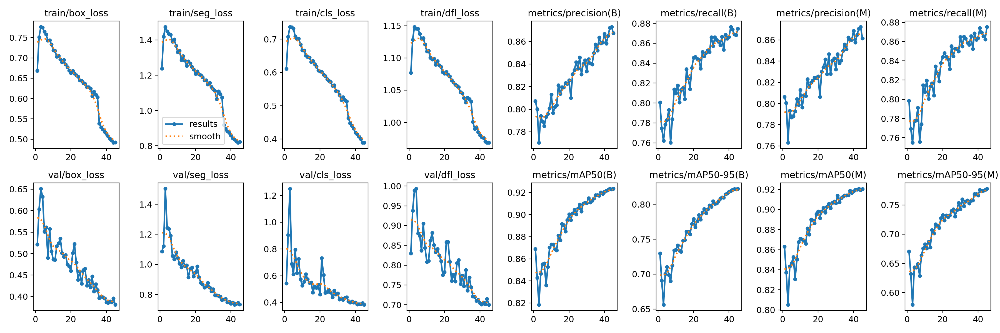


--- confusion_matrix.png ---


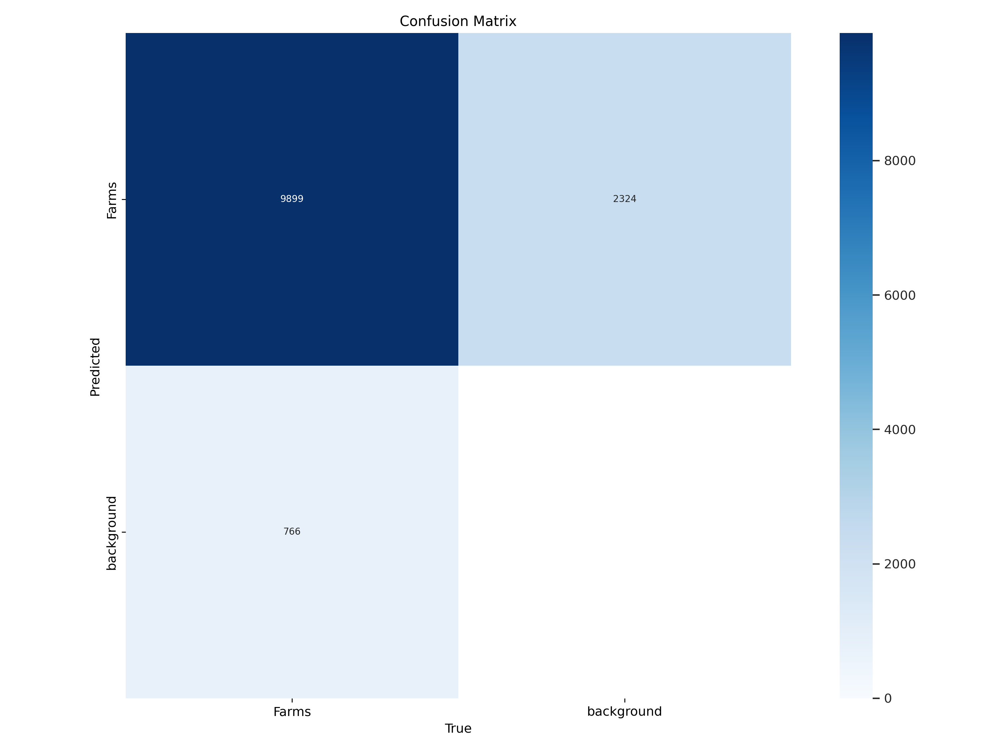


--- val_batch0_labels.jpg ---


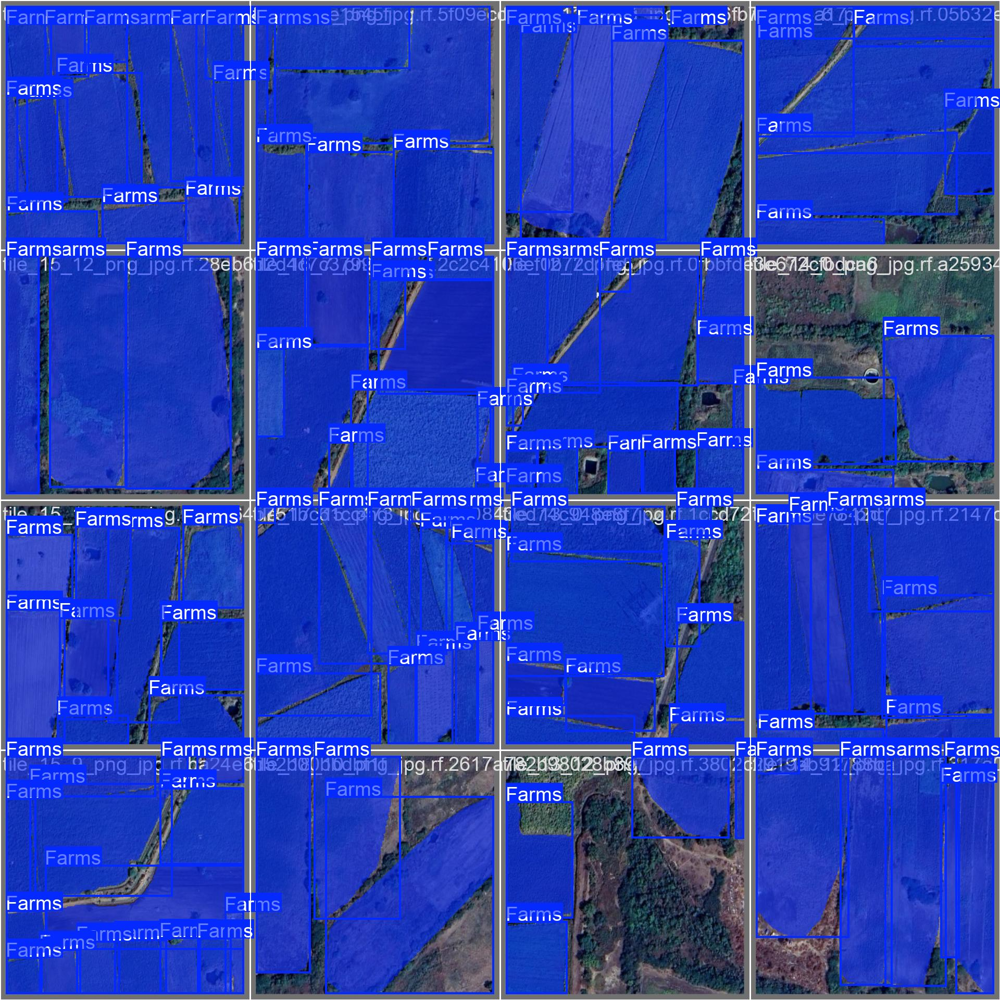


--- val_batch0_pred.jpg ---


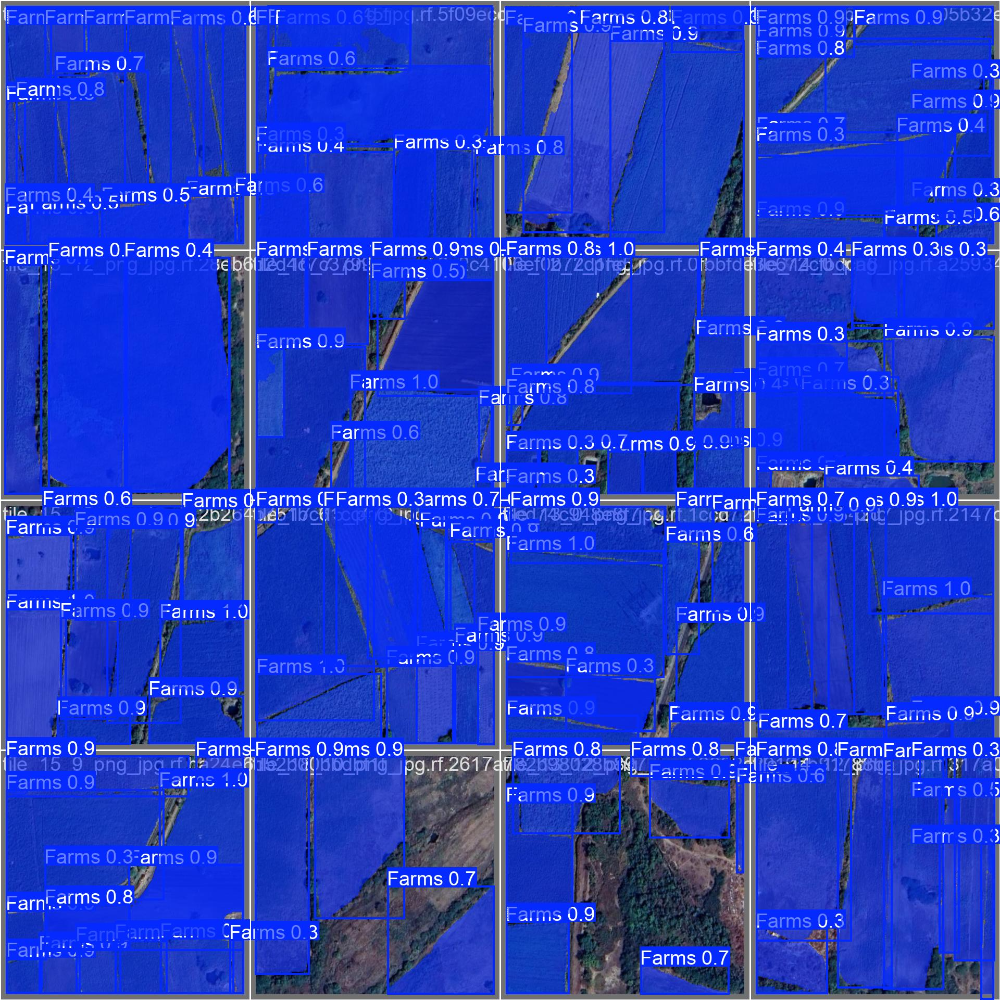

In [14]:
# Display continued training results plots (including loss curves in results.png)
from IPython.display import Image, display

if 'continued_results' in locals() and hasattr(continued_results, 'save_dir'):
    continued_results_dir = continued_results.save_dir
    print(f"Displaying plots from: {continued_results_dir}")
    
    # Common plots saved by YOLOv8
    # results.png contains training/validation loss and metrics curves
    plot_files = [
        'results.png', 
        'confusion_matrix.png', 
        'val_batch0_labels.jpg', # Example batch labels
        'val_batch0_pred.jpg' # Example batch predictions
    ]
    
    found_plots = False
    for plot_file in plot_files:
        plot_path = os.path.join(continued_results_dir, plot_file)
        if os.path.exists(plot_path):
            print(f"\n--- {plot_file} ---")
            display(Image(filename=plot_path, width=800))
            found_plots = True
        else:
            print(f"Plot not found: {plot_path}")
            
    if not found_plots:
        print("Could not find standard result plots. Check the save directory.")
        # List files if needed:
        # print("Files in results directory:", os.listdir(continued_results_dir))
        
else:
    print("Continued training results object ('continued_results') not found. Cannot display plots.")

### Detailed Loss Plots (Continued Training)

Plotting the individual loss components from the `results.csv` file for the continued training run.

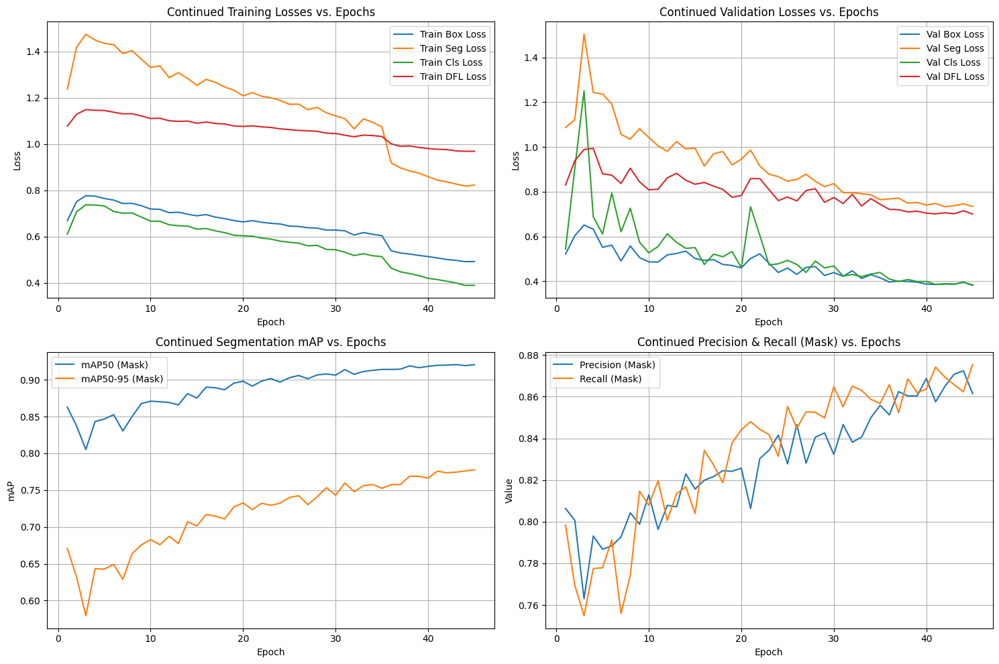

In [15]:
# Plot detailed losses from continued training results.csv
if 'continued_results' in locals() and hasattr(continued_results, 'save_dir'):
    continued_results_csv_path = os.path.join(continued_results.save_dir, 'results.csv')
    if os.path.exists(continued_results_csv_path):
        try:
            df_cont = pd.read_csv(continued_results_csv_path)
            # Clean column names (remove leading/trailing spaces)
            df_cont.columns = df_cont.columns.str.strip()
            
            plt.figure(figsize=(15, 10))
            
            # Plot Training Losses
            plt.subplot(2, 2, 1)
            plt.plot(df_cont['epoch'], df_cont['train/box_loss'], label='Train Box Loss')
            plt.plot(df_cont['epoch'], df_cont['train/seg_loss'], label='Train Seg Loss')
            plt.plot(df_cont['epoch'], df_cont['train/cls_loss'], label='Train Cls Loss')
            if 'train/dfl_loss' in df_cont.columns:
                 plt.plot(df_cont['epoch'], df_cont['train/dfl_loss'], label='Train DFL Loss')
            plt.title('Continued Training Losses vs. Epochs')
            plt.xlabel('Epoch')
            plt.ylabel('Loss')
            plt.legend()
            plt.grid(True)
            
            # Plot Validation Losses
            plt.subplot(2, 2, 2)
            plt.plot(df_cont['epoch'], df_cont['val/box_loss'], label='Val Box Loss')
            plt.plot(df_cont['epoch'], df_cont['val/seg_loss'], label='Val Seg Loss')
            plt.plot(df_cont['epoch'], df_cont['val/cls_loss'], label='Val Cls Loss')
            if 'val/dfl_loss' in df_cont.columns:
                 plt.plot(df_cont['epoch'], df_cont['val/dfl_loss'], label='Val DFL Loss')
            plt.title('Continued Validation Losses vs. Epochs')
            plt.xlabel('Epoch')
            plt.ylabel('Loss')
            plt.legend()
            plt.grid(True)
            
            # Plot mAP Metrics
            plt.subplot(2, 2, 3)
            plt.plot(df_cont['epoch'], df_cont['metrics/mAP50(M)'], label='mAP50 (Mask)')
            plt.plot(df_cont['epoch'], df_cont['metrics/mAP50-95(M)'], label='mAP50-95 (Mask)')
            plt.title('Continued Segmentation mAP vs. Epochs')
            plt.xlabel('Epoch')
            plt.ylabel('mAP')
            plt.legend()
            plt.grid(True)
            
            # Plot Precision and Recall (Mask)
            plt.subplot(2, 2, 4)
            plt.plot(df_cont['epoch'], df_cont['metrics/precision(M)'], label='Precision (Mask)')
            plt.plot(df_cont['epoch'], df_cont['metrics/recall(M)'], label='Recall (Mask)')
            plt.title('Continued Precision & Recall (Mask) vs. Epochs')
            plt.xlabel('Epoch')
            plt.ylabel('Value')
            plt.legend()
            plt.grid(True)
            
            plt.tight_layout()
            plt.show()
            
        except Exception as e:
            print(f"Error plotting continued losses from CSV: {e}")
            # print(df_cont.columns) # Uncomment to debug column names
    else:
        print(f"Continued results.csv not found at: {continued_results_csv_path}")
else:
    print("Continued training results object ('continued_results') not found. Cannot plot detailed losses.")

## 7. Evaluation and Comparison of Re-trained Model

Now, let's evaluate the model that underwent continued fine-tuning and compare its performance metrics and prediction visualizations against the initial fine-tuned model.

In [16]:
# --- Evaluate the Re-trained Model ---
continued_map50_95 = None
continued_map50 = None

# Check if the continued training produced a best model path
if 'continued_best_model_path' in locals() and continued_best_model_path and os.path.exists(continued_best_model_path):
    print(f"Loading re-trained model from: {continued_best_model_path}")
    try:
        retrained_eval_model = YOLO(continued_best_model_path)
        print("Re-trained model loaded successfully for evaluation.")
        
        if data_yaml_path:
            print("\nRunning validation on the re-trained model...")
            retrained_metrics = retrained_eval_model.val(
                data=data_yaml_path,
                imgsz=image_size,
                batch=batch_size, # Use same reverted batch size
                split='val',
                device=device,
                project=project_name,
                name=f'{continued_run_name}_validation', # Save to a new validation folder
                exist_ok=True,
                plots=True # Ensure plots are generated during validation (default)
                # iou=0.6 # Default IoU threshold for metrics calculation
                # conf=0.001 # Default confidence threshold for metrics calculation
            )
            print("\nRe-trained Model Validation complete.")
            print("Re-trained Model Segmentation Metrics:")
            continued_map50_95 = retrained_metrics.seg.map
            continued_map50 = retrained_metrics.seg.map50
            print(f"  mAP50-95 (Mask): {continued_map50_95:.4f}")
            print(f"  mAP50 (Mask):    {continued_map50:.4f}")
        else:
            print("Skipping re-trained model validation: data.yaml path not available.")
            retrained_eval_model = None # Cannot evaluate
            
    except AttributeError:
        print("\nCould not access segmentation metrics (e.g., retrained_metrics.seg.map). This might happen if:")
        print("  - The loaded model is not a segmentation model.")
        print("  - Validation failed to produce segmentation results.")
        print("  - The Ultralytics API version has changed metric accessors.")
        print("  Check the 'retrained_metrics' object structure or validation logs.")
        # print(retrained_metrics) # Uncomment to inspect the metrics object
    except Exception as e:
        print(f"Error loading or validating re-trained model: {e}")
        retrained_eval_model = None
else:
    print("Skipping re-trained model evaluation: Path 'continued_best_model_path' not found or invalid.")
    retrained_eval_model = None

# --- Compare Metrics ---
print("\n--- Metrics Comparison ---")
if 'initial_map50_95' in locals() and initial_map50_95 is not None and \
   'continued_map50_95' in locals() and continued_map50_95 is not None and \
   'initial_map50' in locals() and initial_map50 is not None and \
   'continued_map50' in locals() and continued_map50 is not None:
    print(f"                     Initial Model | Re-trained Model")
    print(f"mAP50-95 (Mask):      {initial_map50_95:^13.4f} | {continued_map50_95:^16.4f}")
    print(f"mAP50 (Mask):         {initial_map50:^13.4f} | {continued_map50:^16.4f}")
    delta_map50_95 = continued_map50_95 - initial_map50_95
    delta_map50 = continued_map50 - initial_map50
    print(f"Delta (Re-trained - Initial):")
    print(f"  Δ mAP50-95: {delta_map50_95:+.4f}")
    print(f"  Δ mAP50:    {delta_map50:+.4f}")
else:
    print("Could not compare metrics. Ensure both initial and continued evaluations ran successfully.")

Loading re-trained model from: FarmWise_YOLOv8_Segmentation/continued_finetune_large_mem_optimized_aug/weights/best.pt
Re-trained model loaded successfully for evaluation.

Running validation on the re-trained model...
Ultralytics 8.3.111 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLOv8l-seg summary (fused): 125 layers, 45,912,659 parameters, 0 gradients, 220.1 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1256.9±310.0 MB/s, size: 43.5 KB)


val: Scanning /kaggle/working/Final-Detectron-2-1/valid/labels.cache... 718 images, 0 backgrounds, 0 corrupt: 100%|██████████| 718/718 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   0%|          | 0/45 [00:00<?, ?it/s]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   2%|▏         | 1/45 [00:01<00:51,  1.17s/it]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   4%|▍         | 2/45 [00:02<00:43,  1.01s/it]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 45/45 [00:23<00:00,  1.90it/s]


                   all        718      10665      0.869      0.874      0.923      0.823      0.861      0.875       0.92      0.773


invalid value encountered in less
invalid value encountered in less


Speed: 0.6ms preprocess, 22.1ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to FarmWise_YOLOv8_Segmentation/continued_finetune_large_mem_optimized_aug_validation

Re-trained Model Validation complete.
Re-trained Model Segmentation Metrics:
  mAP50-95 (Mask): 0.7726
  mAP50 (Mask):    0.9199

--- Metrics Comparison ---
                     Initial Model | Re-trained Model
mAP50-95 (Mask):         0.7586     |      0.7726     
mAP50 (Mask):            0.9110     |      0.9199     
Delta (Re-trained - Initial):
  Δ mAP50-95: +0.0141
  Δ mAP50:    +0.0089



Visualizing predictions from re-trained model on the same sample images...

0: 640x640 29 Farmss, 24.0ms
1: 640x640 1 Farms, 24.0ms
2: 640x640 10 Farmss, 24.0ms
3: 640x640 1 Farms, 24.0ms
4: 640x640 1 Farms, 24.0ms
5: 640x640 1 Farms, 24.0ms
6: 640x640 1 Farms, 24.0ms
7: 640x640 30 Farmss, 24.0ms
8: 640x640 17 Farmss, 24.0ms
9: 640x640 1 Farms, 24.0ms
Speed: 2.1ms preprocess, 24.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Displaying 10 prediction results (Re-trained Model - Masks Only):


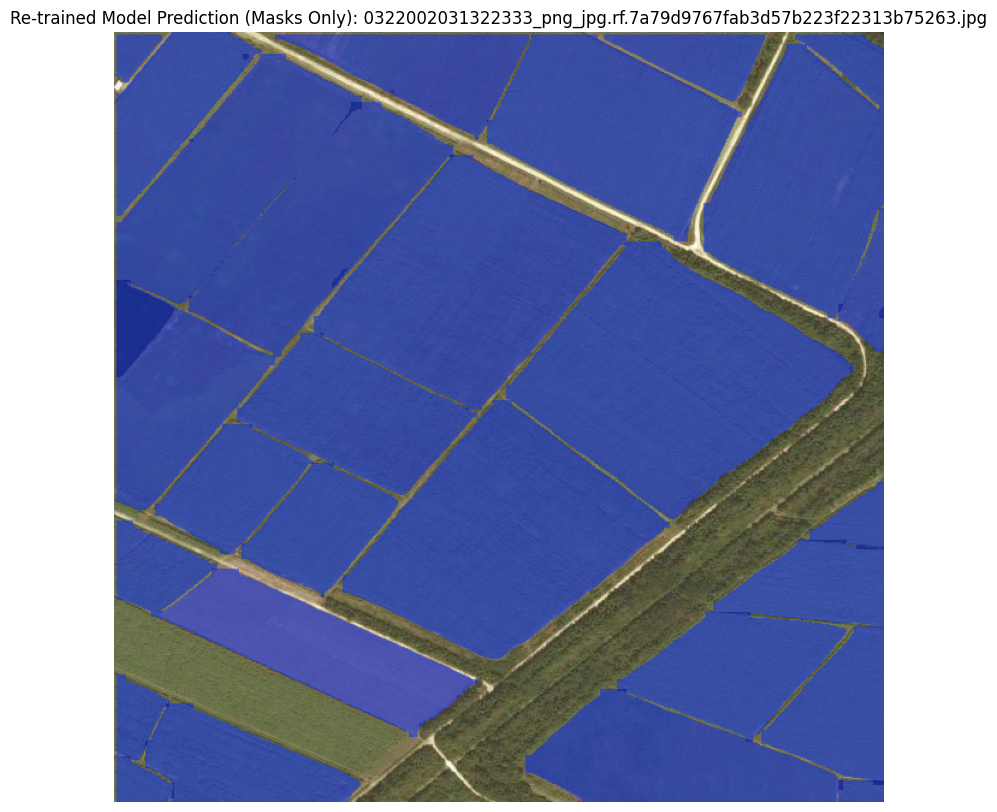

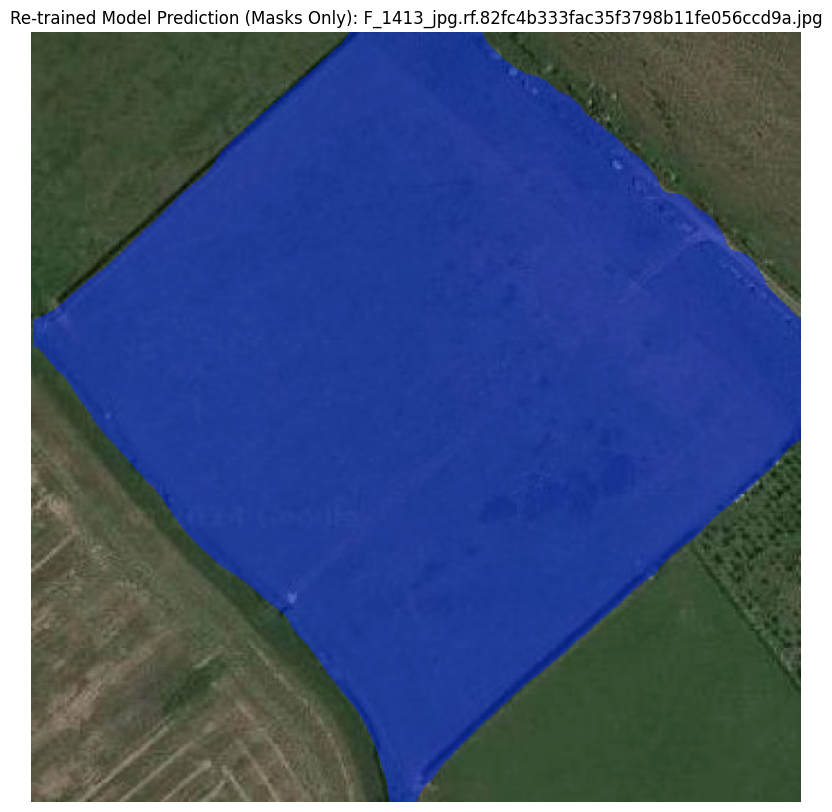

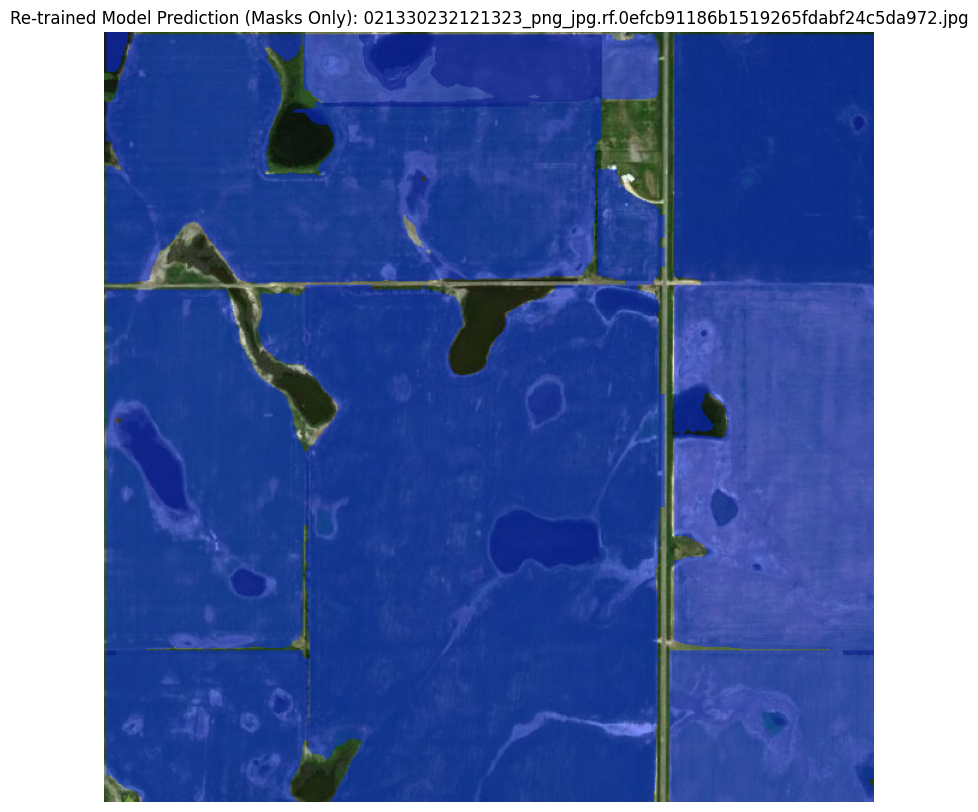

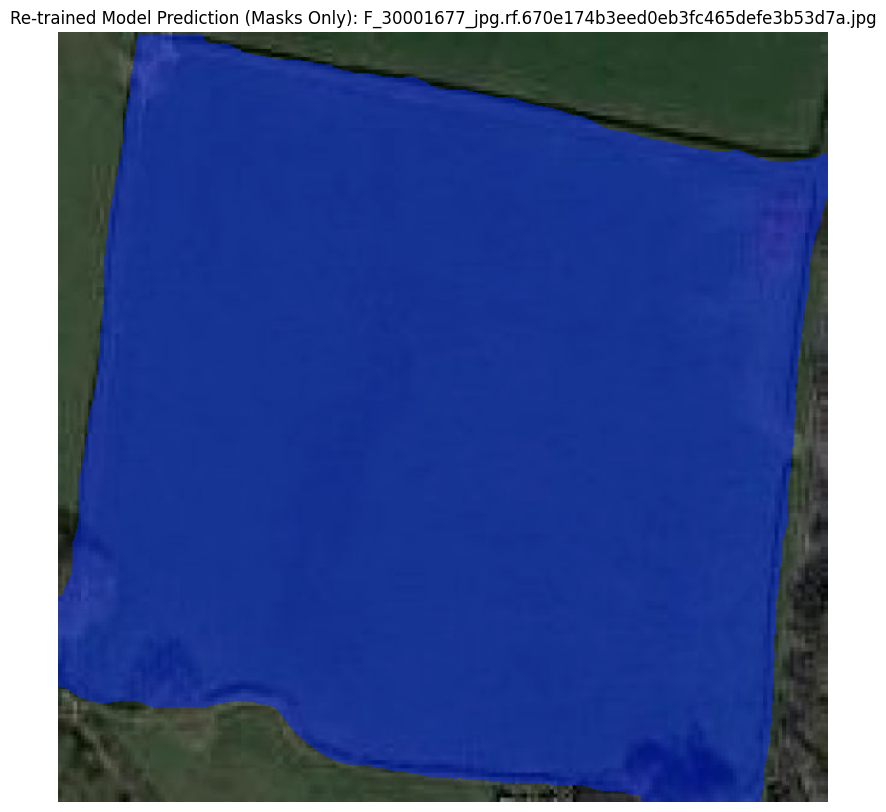

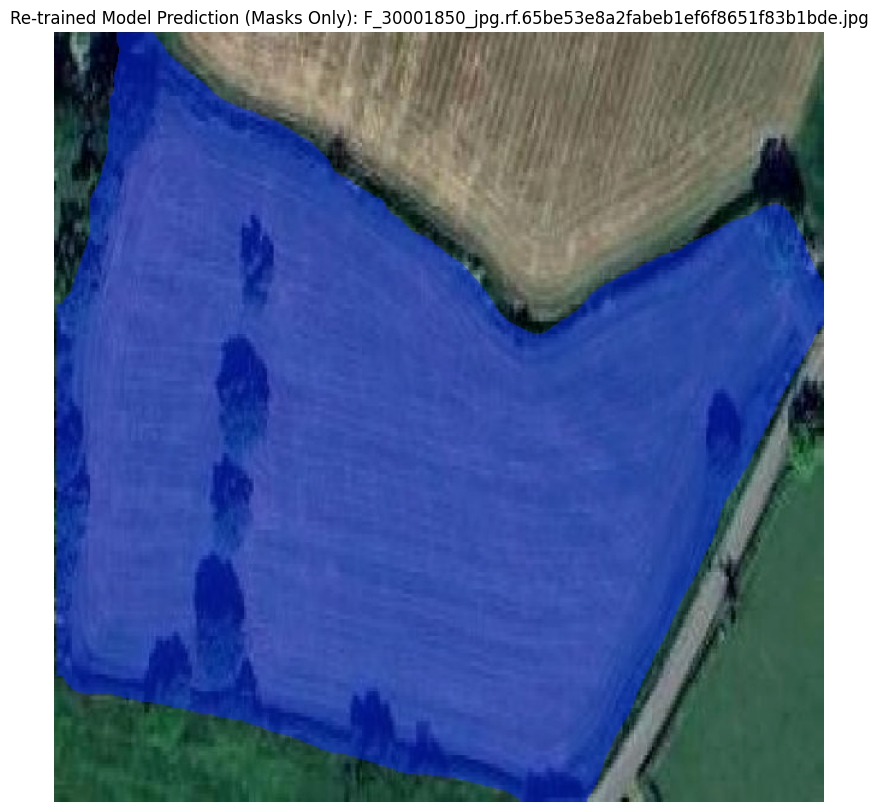

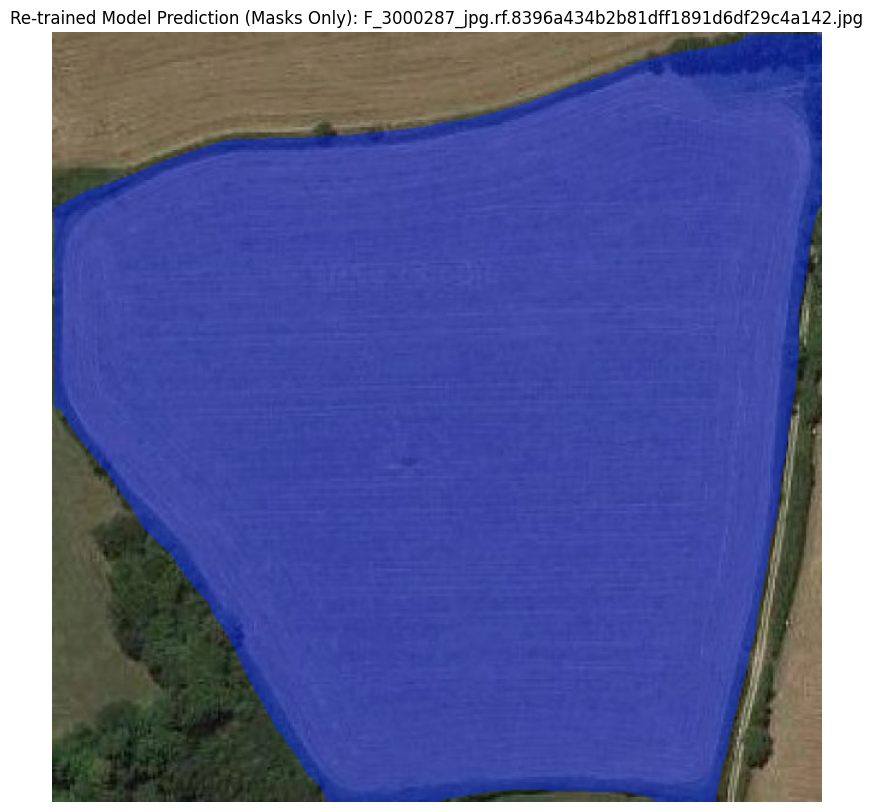

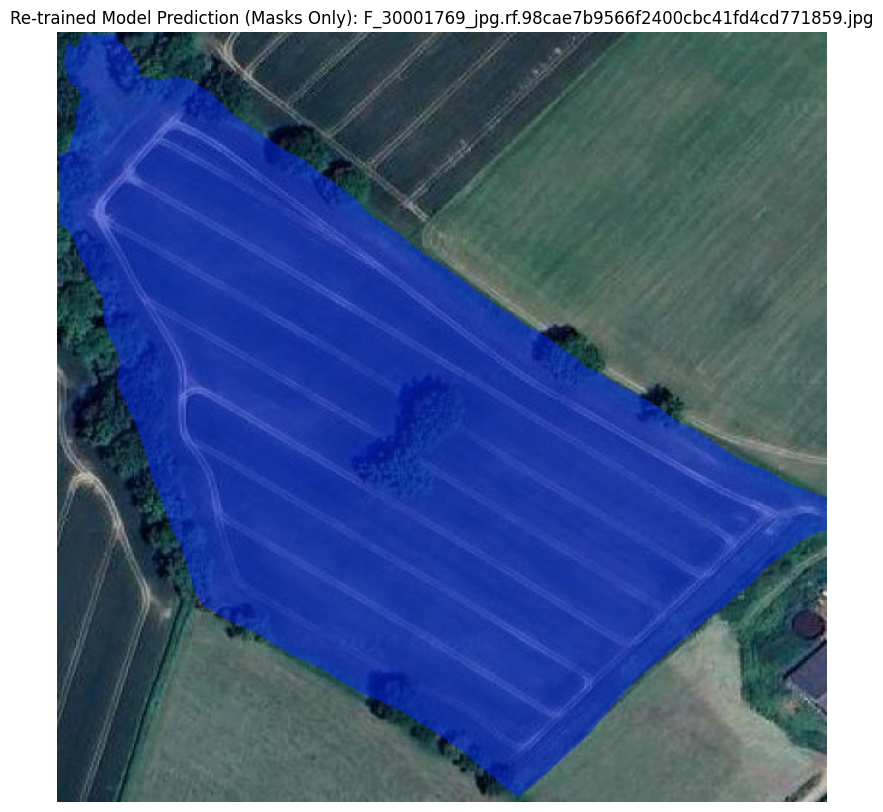

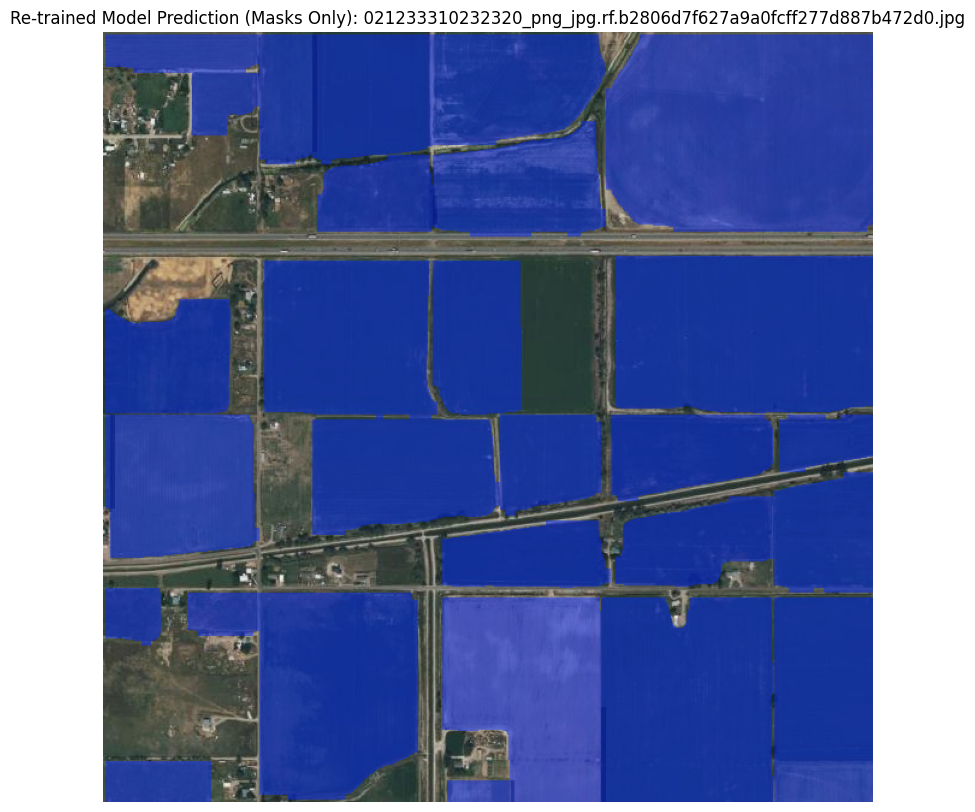

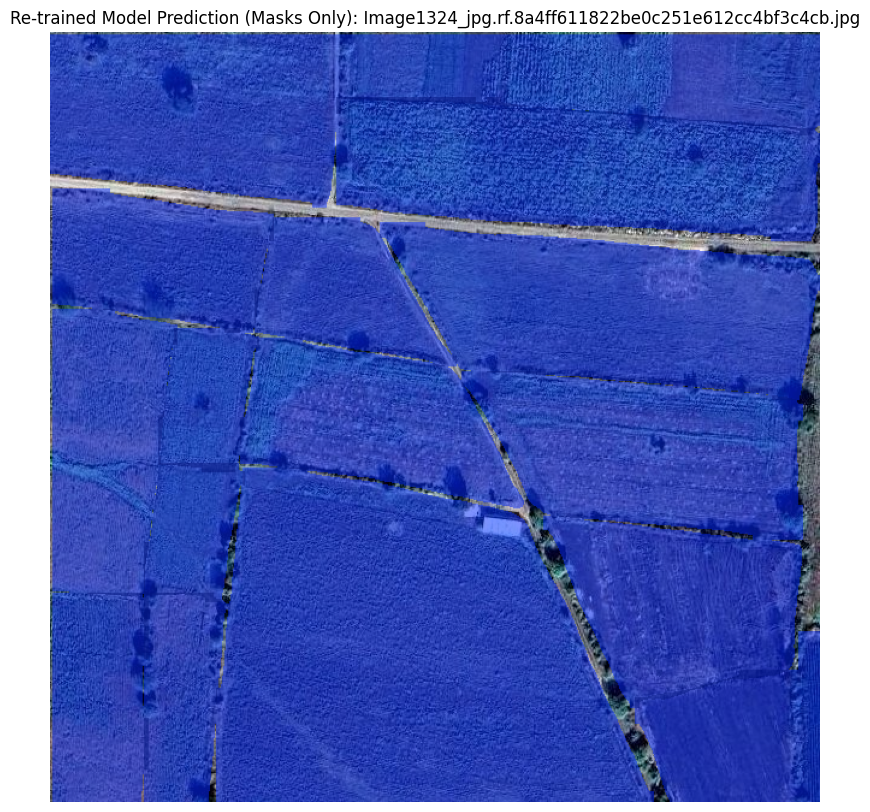

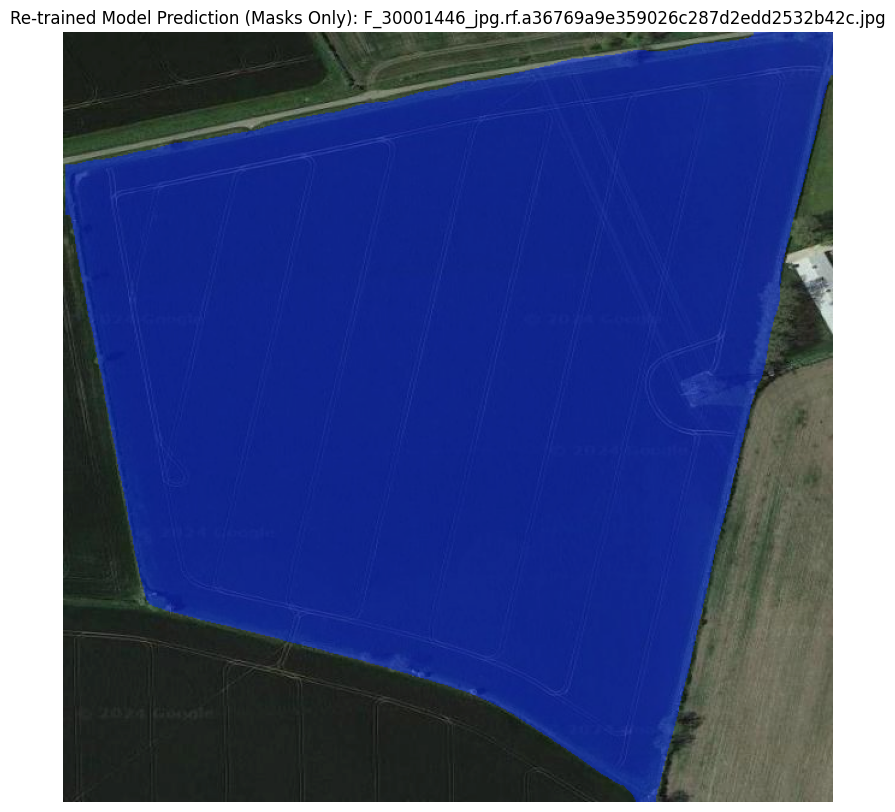

In [17]:
# --- Visualize Re-trained Model Predictions (on the same images) ---
if 'retrained_eval_model' in locals() and retrained_eval_model and 'visualization_sample_images' in locals() and visualization_sample_images:
    print("\nVisualizing predictions from re-trained model on the same sample images...")
    try:
        # Run prediction with the re-trained model using same NMS/conf settings
        retrained_pred_results = retrained_eval_model.predict(
            source=visualization_sample_images, # Use the SAME images stored earlier
            save=False,
            show=False,
            conf=0.5, 
            iou=0.45, # Use same NMS threshold
            device=device
        )
        
        # Plot results using matplotlib, hiding boxes and labels
        print(f"Displaying {len(retrained_pred_results)} prediction results (Re-trained Model - Masks Only):")
        for i, r in enumerate(retrained_pred_results):
            # Use plot() with boxes=False and labels=False
            im_bgr = r.plot(boxes=False, labels=False)  
            im_rgb = PILImage.fromarray(im_bgr[..., ::-1]) # Convert BGR to RGB using PILImage
            
            plt.figure(figsize=(10, 10))
            plt.imshow(im_rgb)
            plt.title(f"Re-trained Model Prediction (Masks Only): {os.path.basename(visualization_sample_images[i])}")
            plt.axis('off')
            plt.show()
            
    except Exception as e:
        print(f"\nError during re-trained model prediction or visualization: {e}")
        traceback.print_exc()
else:
    print("\nSkipping re-trained prediction visualization: Re-trained model or sample image list not available.")

### Post-processing on Re-trained Model Results

Let's apply the same farm size calculation and classification to the predictions made by the re-trained model to see the final output.

In [18]:
# --- Run Post-processing on the re-trained predictions ---
if 'retrained_pred_results' in locals() and retrained_pred_results:
    print("\nCalculating farm sizes and categories for re-trained model samples...")
    retrained_farm_data = calculate_farm_properties(retrained_pred_results, confidence_threshold=0.5, min_area_pixels=500)
    
    # Display calculated data
    import json
    print("\n--- Re-trained Model Farm Size Calculation Results ---")
    for img_result in retrained_farm_data:
        print(f"Image: {img_result['image_path']}")
        if img_result['farms']:
            for farm in img_result['farms']:
                print(f"  - Farm ID: {farm['id']}, Area: {farm['area_pixels']:.0f} pixels, Category: {farm['size_category']}, Confidence: {farm['confidence']:.2f}")
        else:
            print("  No farms detected or meeting criteria.")
        print("---")
else:
    print("\nSkipping re-trained farm size calculation: No prediction results available from the re-trained model visualization cell.")


Calculating farm sizes and categories for re-trained model samples...
Processing 10 prediction results...

--- Re-trained Model Farm Size Calculation Results ---
Image: 0322002031322333_png_jpg.rf.7a79d9767fab3d57b223f22313b75263.jpg
  - Farm ID: 1, Area: 21393 pixels, Category: Large, Confidence: 0.96
  - Farm ID: 2, Area: 7942 pixels, Category: Medium, Confidence: 0.96
  - Farm ID: 3, Area: 7793 pixels, Category: Medium, Confidence: 0.95
  - Farm ID: 4, Area: 14140 pixels, Category: Medium, Confidence: 0.95
  - Farm ID: 5, Area: 14549 pixels, Category: Medium, Confidence: 0.95
  - Farm ID: 6, Area: 8886 pixels, Category: Medium, Confidence: 0.94
  - Farm ID: 7, Area: 30980 pixels, Category: Large, Confidence: 0.94
  - Farm ID: 8, Area: 22344 pixels, Category: Large, Confidence: 0.93
  - Farm ID: 9, Area: 9312 pixels, Category: Medium, Confidence: 0.92
  - Farm ID: 10, Area: 4178 pixels, Category: Small, Confidence: 0.91
  - Farm ID: 11, Area: 29749 pixels, Category: Large, Confidenc

## 8. Comparison Summary

This section summarizes the performance difference between the initial fine-tuned model and the model after continued fine-tuning. Review the metrics comparison table and the side-by-side visualizations generated in the previous section (Section 7).

**Key aspects to compare:**

*   **Metrics**: Did the mAP scores (mAP50-95 and mAP50) improve after continued fine-tuning? A positive delta indicates improvement.
*   **Visualizations**: Compare the segmentation masks produced by the initial model and the re-trained model for the same images. Look for:
    *   More accurate boundaries around farms.
    *   Fewer false positives (incorrectly identified areas).
    *   Fewer false negatives (missed farms).
    *   Better separation of adjacent farms.

Based on this comparison, decide if the continued fine-tuning was beneficial and if further training or hyperparameter adjustments are needed.

Below, we re-display the calculated metrics for easy reference:

In [19]:
# --- Re-display Metrics Comparison ---
print("\n--- Metrics Comparison (from Section 7) ---")
if 'initial_map50_95' in locals() and initial_map50_95 is not None and \
   'continued_map50_95' in locals() and continued_map50_95 is not None and \
   'initial_map50' in locals() and initial_map50 is not None and \
   'continued_map50' in locals() and continued_map50 is not None:
    print(f"                     Initial Model | Re-trained Model")
    print(f"mAP50-95 (Mask):      {initial_map50_95:^13.4f} | {continued_map50_95:^16.4f}")
    print(f"mAP50 (Mask):         {initial_map50:^13.4f} | {continued_map50:^16.4f}")
    delta_map50_95 = continued_map50_95 - initial_map50_95
    delta_map50 = continued_map50 - initial_map50
    print(f"Delta (Re-trained - Initial):")
    print(f"  Δ mAP50-95: {delta_map50_95:+.4f}")
    print(f"  Δ mAP50:    {delta_map50:+.4f}")
else:
    print("Metrics data not available. Ensure Section 7 (Evaluation and Comparison) ran successfully.")


--- Metrics Comparison (from Section 7) ---
                     Initial Model | Re-trained Model
mAP50-95 (Mask):         0.7586     |      0.7726     
mAP50 (Mask):            0.9110     |      0.9199     
Delta (Re-trained - Initial):
  Δ mAP50-95: +0.0141
  Δ mAP50:    +0.0089


## 9. Model Export for Deployment (e.g., Kaggle)

Finally, let's export the best performing model (likely the one after continued fine-tuning) to a standard format like ONNX. This format is widely supported and suitable for deployment in various environments, including Kaggle notebooks or custom applications.

In [20]:
# --- Export the Final Model ---

# Determine the path to the final best model (prefer the continued one if it exists and performed better)
final_model_path = None
export_run_name = None

# Check if continued training happened and produced a model
continued_exists = 'continued_best_model_path' in locals() and continued_best_model_path and os.path.exists(continued_best_model_path)
initial_exists = 'best_model_path' in locals() and best_model_path and os.path.exists(best_model_path)

if continued_exists:
    # Optional: Add logic here to compare continued_map50_95 and initial_map50_95 if both exist
    # For now, assume continued is preferred if it exists
    final_model_path = continued_best_model_path
    # Use the correct run name for the continued run
    export_run_name = continued_run_name if 'continued_run_name' in locals() else 'continued_run'
    print(f"Selected the re-trained model for export: {final_model_path}")
elif initial_exists:
    final_model_path = best_model_path
    # Use the correct run name for the initial run
    export_run_name = run_name if 'run_name' in locals() else 'initial_run'
    print(f"Selected the initial fine-tuned model for export (re-trained model not found/available): {final_model_path}")
else:
    print("Error: No valid '.pt' model path found to export. Ensure at least one training run completed successfully.")

if final_model_path:
    try:
        print("\nLoading the final model for export...")
        export_model = YOLO(final_model_path)
        
        # Define export parameters
        export_format = 'onnx' # Other options: 'torchscript', 'engine', 'pb', etc.
        # The export path will be relative to the notebook or you can specify an absolute path
        # It usually saves within the last run's directory or you can specify opset
        # Add nms=True to include NMS operations in the exported graph if supported
        export_path = export_model.export(
            format=export_format, 
            imgsz=image_size, 
            opset=12, # Common opset for compatibility
            nms=True # Include NMS in the export if possible
            # Note: Specific NMS parameters like iou/conf are typically applied during inference runtime, not baked into the ONNX model itself.
        )
        
        print(f"\nModel successfully exported to {export_format} format.")
        print(f"Exported model saved at: {export_path}")
        print(f"\nYou can now use the file '{export_path}' for deployment.")
        
    except Exception as e:
        print(f"\nAn error occurred during model export: {e}")
        traceback.print_exc()
else:
    print("\nSkipping model export.")

Selected the re-trained model for export: FarmWise_YOLOv8_Segmentation/continued_finetune_large_mem_optimized_aug/weights/best.pt

Loading the final model for export...
Ultralytics 8.3.111 🚀 Python-3.11.11 torch-2.5.1+cu124 CPU (Intel Xeon 2.00GHz)
YOLOv8l-seg summary (fused): 125 layers, 45,912,659 parameters, 0 gradients, 220.1 GFLOPs

PyTorch: starting from 'FarmWise_YOLOv8_Segmentation/continued_finetune_large_mem_optimized_aug/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) ((1, 300, 38), (1, 32, 160, 160)) (88.0 MB)
requirements: Ultralytics requirements ['onnxslim', 'onnxruntime-gpu'] not found, attempting AutoUpdate...
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 144.5/144.5 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 280.8/280.8 MB 249.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 239.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 247.3 MB/s eta 0:00:00

requirements: 